In [1]:
!pip install matplotlib

In [2]:
import tensorflow as tf
from tensorflow.keras import layers, Model
import numpy as np
import matplotlib.pyplot as plt
import os
import time

2025-06-06 08:42:42.117353: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-06 08:42:42.261681: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749192162.313731   24572 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749192162.328135   24572 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1749192162.454734   24572 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [ ]:
# --- CONFIGURATION ---
IMG_SHAPE = (128, 128, 3)
NUM_CLASSES = 4
LATENT_DIM = 256
BATCH_SIZE = 32 #32
EPOCHS = 500 #optimal 500 - 1000
SAVE_INTERVAL = 5  # Save/checkpoint/generate every 5 epochs
CHECKPOINT_DIR = "./cgan_checkpoints"
GENERATED_IMAGES_DIR = "./generated_images"
os.makedirs(CHECKPOINT_DIR, exist_ok=True)
os.makedirs(GENERATED_IMAGES_DIR, exist_ok=True)

In [4]:
# Path to the root directory of your dataset
dataset_root = "./OASIS_balanced_scaled_128px_12000"

# Parameters
img_height = 128
img_width = 128

In [ ]:
# Split into training, test and validation (e.g., 70% train, 15% test, 15% val)
full_ds = tf.keras.utils.image_dataset_from_directory(
    dataset_root,
    image_size=(128, 128),
    batch_size=BATCH_SIZE,
    label_mode="int",
    shuffle=True,
    seed=123
)

# Count total batches
dataset_size = tf.data.experimental.cardinality(full_ds).numpy()
train_size = int(0.7 * dataset_size)
val_size = int(0.15 * dataset_size)
test_size = dataset_size - train_size - val_size

train_ds = full_ds.take(train_size)
val_ds = full_ds.skip(train_size).take(val_size)
test_ds = full_ds.skip(train_size + val_size)

Found 12000 files belonging to 4 classes.


I0000 00:00:1749192223.723844   24572 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9502 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4070 Ti, pci bus id: 0000:01:00.0, compute capability: 8.9


In [6]:
# --- PREPROCESSING STEP ---
normalization_layer = tf.keras.layers.Rescaling(1./127.5, offset=-1)

def preprocess(image, label):
    image = normalization_layer(image)
    return image, label

train_ds = train_ds.map(preprocess)
val_ds = val_ds.map(preprocess)
test_ds = test_ds.map(preprocess)

In [ ]:
# --- MODEL DEFINITIONS ---

# --- GENERATOR ---
def build_generator():
    noise = layers.Input(shape=(LATENT_DIM,))
    label = layers.Input(shape=(1,), dtype='int32')
    label_embedding = layers.Embedding(NUM_CLASSES, LATENT_DIM)(label)
    label_embedding = layers.Flatten()(label_embedding)
    model_input = layers.Multiply()([noise, label_embedding])

    x = layers.Dense(16*16*256, use_bias=False)(model_input)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Reshape((16, 16, 256))(x)

    x = layers.Conv2DTranspose(128, 5, strides=2, padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(64, 5, strides=2, padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(32, 5, strides=2, padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    output = layers.Conv2D(3, 7, activation='tanh', padding='same')(x)
    return Model([noise, label], output, name='generator')

In [8]:
from tensorflow.keras.layers import SpectralNormalization

# --- DISCRIMINATOR ---
def build_discriminator():
    img = layers.Input(shape=IMG_SHAPE)
    label = layers.Input(shape=(1,), dtype='int32')

    # Label embedding
    label_embedding = layers.Embedding(NUM_CLASSES, np.prod(IMG_SHAPE))(label)
    label_embedding = layers.Flatten()(label_embedding)
    label_embedding = layers.Reshape(IMG_SHAPE)(label_embedding)

    # Concatenate image and label
    x = layers.Concatenate()([img, label_embedding])

    # Add spectral normalization to all Conv2D layers
    x = SpectralNormalization(layers.Conv2D(64, 5, strides=2, padding='same'))(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = SpectralNormalization(layers.Conv2D(128, 5, strides=2, padding='same'))(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = SpectralNormalization(layers.Conv2D(256, 5, strides=2, padding='same'))(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Flatten()(x)
    real_fake = layers.Dense(1, activation='sigmoid')(x)
    return Model([img, label], real_fake, name='discriminator')

In [9]:
generator = build_generator()
discriminator = build_discriminator()

In [10]:
# --- LOSS AND OPTIMIZERS ---
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

# --- OPTIMIZERS WITH LEARNING RATE DECAY ---
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,  # Changed from 'lr' to 'learning_rate'
    beta_1=0.5,
    weight_decay=1e-6  # Weight decay (L2 regularization)
)

discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,  # Changed from 'lr' to 'learning_rate'
    beta_1=0.5,
    weight_decay=1e-6  # Weight decay (L2 regularization)
)

In [11]:
# --- CHECKPOINT ---
checkpoint = tf.train.Checkpoint(
    generator=generator,
    discriminator=discriminator,
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer
)

In [12]:
# --- FIXED NOISE/LABELS FOR VISUALIZATION ---
fixed_noise = tf.random.normal([16, LATENT_DIM])
fixed_labels = tf.constant([[i % NUM_CLASSES] for i in range(16)])

In [13]:
# --- TRAINING FUNCTIONS ---
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return (real_loss + fake_loss) * 0.5

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [14]:
@tf.function
def train_step(images, labels):
    noise = tf.random.normal([BATCH_SIZE, LATENT_DIM])
    random_labels = tf.random.uniform([BATCH_SIZE, 1], 0, NUM_CLASSES, dtype=tf.int32)

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator([noise, random_labels], training=True)

        real_output = discriminator([images, labels], training=True)
        fake_output = discriminator([generated_images, random_labels], training=True)

        d_loss = discriminator_loss(real_output, fake_output)
        g_loss = generator_loss(fake_output)

    gradients_of_generator = gen_tape.gradient(g_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(d_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    return d_loss, g_loss

In [15]:
def generate_and_save_images(model, epoch, test_noise, test_labels):
    predictions = model([test_noise, test_labels], training=False)
    predictions = (predictions + 1) / 2.0  # Scale to [0,1]
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow(predictions[i].numpy())
        plt.axis('off')
    plt.suptitle(f'Generated Images at Epoch {epoch}')
    plt.tight_layout()
    plt.savefig(f'generated_images_epoch_{epoch:04d}.png')
    plt.show()
    plt.close()

In [16]:
!pip install scipy

In [17]:
!pip install scikit-learn

In [18]:
from tensorflow.keras.applications import InceptionV3
from scipy.linalg import sqrtm
from sklearn.neighbors import NearestNeighbors

# --- METRIC CALCULATION UTILITIES ---
class GANMetrics:
    def __init__(self, real_dataset, latent_dim, num_classes, batch_size=BATCH_SIZE, num_samples=512):
        self.inception = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
        self.batch_size = batch_size
        self.num_samples = num_samples
        self.latent_dim = latent_dim
        self.num_classes = num_classes
        # Precompute real stats
        self.real_mu, self.real_sigma, self.real_features = self._precompute_real_stats(real_dataset)

    def preprocess_inception(self, images):
        images = tf.image.resize(images, (299, 299))
        return tf.keras.applications.inception_v3.preprocess_input(images)

    def _precompute_real_stats(self, real_dataset):
        # Collect enough samples (up to num_samples)
        real_images = []
        for img_batch, _ in real_dataset.unbatch().batch(self.batch_size):
            real_images.append(img_batch)
            if sum([x.shape[0] for x in real_images]) >= self.num_samples:
                break
        real_images = tf.concat(real_images, axis=0)[:self.num_samples]
        real_images = self.preprocess_inception(real_images)
        real_features = self.inception.predict(real_images, batch_size=self.batch_size, verbose=0)
        mu = real_features.mean(axis=0)
        sigma = np.cov(real_features, rowvar=False).astype(np.float64)
        return mu, sigma, real_features

    # --- CALCULATING FID SCORE ---
    def calculate_fid(self, gen_images):
        gen_images = self.preprocess_inception(gen_images)
        features = []

        # Batch processing implementation
        num_samples = gen_images.shape[0]
        for i in range(0, num_samples, self.batch_size):
            batch = gen_images[i:i+self.batch_size]
            batch_features = self.inception.predict(batch, verbose=0)
            features.extend(batch_features)

        features = np.array(features)
        mu_gen = features.mean(axis=0)
        sigma_gen = np.cov(features, rowvar=False).astype(np.float64)

        diff = self.real_mu - mu_gen
        covmean = sqrtm(self.real_sigma.dot(sigma_gen))
        if np.iscomplexobj(covmean):
            covmean = covmean.real
        fid = diff.dot(diff) + np.trace(self.real_sigma + sigma_gen - 2 * covmean)
        return fid

     # --- CALCULATING PRECISION AND RECALL ---
    def calculate_precision_recall(self, gen_images, k=3):
        gen_images = self.preprocess_inception(gen_images)
        gen_features = self.inception.predict(gen_images, batch_size=self.batch_size, verbose=0)
        real_features = self.real_features

        # Calculate manifold distances for real data
        real_nbrs = NearestNeighbors(n_neighbors=k+1).fit(real_features)
        real_distances, _ = real_nbrs.kneighbors(real_features)
        real_radii = real_distances[:, k]  # k-th neighbor distance (manifold radius)

        # Calculate precision: generated samples within real manifold
        gen_nbrs = NearestNeighbors(n_neighbors=k).fit(real_features)
        gen_distances, _ = gen_nbrs.kneighbors(gen_features)
        gen_radii = gen_distances[:, k-1]  # k-th neighbor distance to real data

        # Calculate recall: real samples covered by generated manifold
        real_gen_nbrs = NearestNeighbors(n_neighbors=k).fit(gen_features)
        real_gen_distances, _ = real_gen_nbrs.kneighbors(real_features)
        real_gen_radii = real_gen_distances[:, k-1]

        # Use median real manifold radius as threshold
        manifold_threshold = np.median(real_radii)

        precision = np.mean(gen_radii <= manifold_threshold)
        recall = np.mean(real_gen_radii <= manifold_threshold)

        return precision, recall

    # --- CALCULATING Kernel Maximum Mean Discrepancy (MMD) ---
    def calculate_mmd(self, gen_images, kernel='rbf', sigma=1.0):
        # Use Inception features for MMD, as with FID
        gen_images = self.preprocess_inception(gen_images)
        gen_features = self.inception.predict(gen_images, batch_size=self.batch_size, verbose=0)
        real_features = self.real_features

        # Compute pairwise distances
        def compute_kernel(x, y):
            x_size = x.shape[0]
            y_size = y.shape[0]
            dim = x.shape[1]
            x = np.expand_dims(x, 1)  # (x_size, 1, dim)
            y = np.expand_dims(y, 0)  # (1, y_size, dim)
            return np.exp(-np.sum((x - y) ** 2, axis=2) / (2 * sigma ** 2))

        K_XX = compute_kernel(gen_features, gen_features)
        K_YY = compute_kernel(real_features, real_features)
        K_XY = compute_kernel(gen_features, real_features)

        mmd = K_XX.mean() + K_YY.mean() - 2 * K_XY.mean()
        return mmd

    # --- 1-Nearest-Neighbor (1-NN) Two-Sample Test ---
    def calculate_1nn(self, gen_images):
        gen_images = self.preprocess_inception(gen_images)
        gen_features = self.inception.predict(gen_images, batch_size=self.batch_size, verbose=0)
        # real_features = self.inception.predict(self.preprocess_inception(self.real_images), batch_size=self.batch_size, verbose=0)
        real_features = self.real_features

        X = np.concatenate([real_features, gen_features], axis=0)
        y = np.array([0]*len(real_features) + [1]*len(gen_features))

        nbrs = NearestNeighbors(n_neighbors=2).fit(X)
        distances, indices = nbrs.kneighbors(X)
        nn_labels = y[indices[:, 1]]
        accuracy = (nn_labels == y).mean()
        # 1-NN accuracy closer to 0.5 means distributions are similar
        return accuracy

    # --- Creativity-Inheritance-Diversity (CID) Index ---
    def calculate_cid(self, gen_images):
        gen_images = self.preprocess_inception(gen_images)
        gen_features = self.inception.predict(gen_images, batch_size=self.batch_size, verbose=0)
        # real_features = self.inception.predict(self.preprocess_inception(self.real_images), batch_size=self.batch_size, verbose=0)
        # Use precomputed real_features
        real_features = self.real_features

        # Creativity: mean min distance to real
        from scipy.spatial.distance import cdist
        dists = cdist(gen_features, real_features, 'euclidean')
        creativity = np.mean(np.min(dists, axis=1))

        # Inheritance: mean max similarity (cosine)
        from sklearn.metrics.pairwise import cosine_similarity
        similarities = cosine_similarity(gen_features, real_features)
        inheritance = np.mean(np.max(similarities, axis=1))

        # Diversity: mean pairwise distance within generated
        div_dists = cdist(gen_features, gen_features, 'euclidean')
        diversity = np.mean(div_dists)

        # Combine (weights can be tuned)
        cid_score = creativity + (1 - inheritance) + diversity
        return {'creativity': creativity, 'inheritance': inheritance, 'diversity': diversity, 'cid_score': cid_score}

In [ ]:
# --- MODIFIED EVALUATION FUNCTION ---

fid_scores = []
precision_scores = []
recall_scores = []
mmd_scores = []
one_nn_scores = []
cid_scores = []
cid_creativity = []
cid_inheritance = []
cid_diversity = []

epochs_recorded = []

def evaluate_gan(generator, metric_calculator, latent_dim, num_classes, batch_size=BATCH_SIZE, num_samples=512, epoch=None):
    gen_images = []
    # Generate images with random labels
    for _ in range((num_samples + batch_size - 1) // batch_size):
        current_batch = min(batch_size, num_samples - len(gen_images) * batch_size)
        noise = tf.random.normal([current_batch, latent_dim])
        labels = tf.random.uniform([current_batch, 1], 0, num_classes, dtype=tf.int32)
        gen = generator([noise, labels], training=False)
        gen_images.append(gen)
        if sum([x.shape[0] for x in gen_images]) >= num_samples:
            break
    gen_images = tf.concat(gen_images, axis=0)[:num_samples]
    fid = metric_calculator.calculate_fid(gen_images)
    precision, recall = metric_calculator.calculate_precision_recall(gen_images)

    mmd = metric_calculator.calculate_mmd(gen_images)
    one_nn = metric_calculator.calculate_1nn(gen_images)
    cid = metric_calculator.calculate_cid(gen_images)

    if epoch is not None:
        fid_scores.append(fid)
        precision_scores.append(precision)
        recall_scores.append(recall)
        mmd_scores.append(mmd)
        one_nn_scores.append(one_nn)
        cid_scores.append(cid['cid_score'])
        cid_creativity.append(cid['creativity'])
        cid_inheritance.append(cid['inheritance'])
        cid_diversity.append(cid['diversity'])
        epochs_recorded.append(epoch)
    print(f"[Evaluation] FID: {fid:.2f} | Precision: {precision:.3f} | Recall: {recall:.3f}")
    print(f"[Evaluation] MMD: {mmd:.4f} | 1-NN: {one_nn:.4f} | CID: {cid}")
    return fid, precision, recall, mmd, one_nn, cid

In [21]:
# --- PLOTTING FUNCTION ---
def plot_training_metrics():
    """Plot FID, Precision, Recall, MMD, 1-NN, CID index over training epochs"""
    num_metrics = 6
    plt.figure(figsize=(5 * num_metrics, 5))

    # FID
    plt.subplot(1, num_metrics, 1)
    plt.plot(epochs_recorded, fid_scores, 'b-o')
    plt.title("FID Score")
    plt.xlabel("Epoch")
    plt.ylabel("FID")
    plt.grid(True)

    # MMD
    plt.subplot(1, num_metrics, 2)
    plt.plot(epochs_recorded, mmd_scores, 'm-o')
    plt.title("MMD")
    plt.xlabel("Epoch")
    plt.ylabel("MMD")
    plt.grid(True)

    # 1-NN
    plt.subplot(1, num_metrics, 3)
    plt.plot(epochs_recorded, one_nn_scores, 'c-o')
    plt.title("1-NN Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("1-NN")
    plt.grid(True)

    # CID Score
    plt.subplot(1, num_metrics, 4)
    plt.plot(epochs_recorded, cid_scores, 'k-o')
    plt.title("CID Index")
    plt.xlabel("Epoch")
    plt.ylabel("CID")
    plt.grid(True)

    # CID Components
    plt.subplot(1, num_metrics, 5)
    plt.plot(epochs_recorded, cid_creativity, 'r-', label='Creativity')
    plt.plot(epochs_recorded, cid_inheritance, 'g-', label='Inheritance')
    plt.plot(epochs_recorded, cid_diversity, 'b-', label='Diversity')
    plt.title("CID Components")
    plt.xlabel("Epoch")
    plt.legend()
    plt.grid(True)

    # Precision/Recall
    plt.subplot(1, num_metrics, 6)
    plt.plot(epochs_recorded, precision_scores, 'g-', label='Precision')
    plt.plot(epochs_recorded, recall_scores, 'r-', label='Recall')
    plt.title("Precision/Recall")
    plt.xlabel("Epoch")
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.savefig("training_metrics_extended.png")
    plt.close()

In [22]:
# --- TRAINING LOOP ---
def train(dataset, epochs, val_dataset=None):
    metric_calculator = None
    if val_dataset is not None:
        metric_calculator = GANMetrics(
            real_dataset=val_dataset,
            latent_dim=LATENT_DIM,
            num_classes=NUM_CLASSES,
            batch_size=BATCH_SIZE,
            num_samples=512
        )
    for epoch in range(1, epochs + 1):
        start = time.time()
        for image_batch, label_batch in dataset:
            d_loss, g_loss = train_step(image_batch, label_batch)
        print(f'Epoch {epoch}, d_loss: {d_loss.numpy():.4f}, g_loss: {g_loss.numpy():.4f}, time: {time.time()-start:.2f}s')

        if epoch % SAVE_INTERVAL == 0:
            checkpoint.save(file_prefix=os.path.join(CHECKPOINT_DIR, "ckpt"))
            generate_and_save_images(generator, epoch, fixed_noise, fixed_labels)
            if val_dataset is not None:
                evaluate_gan(generator, metric_calculator, LATENT_DIM, NUM_CLASSES, batch_size=BATCH_SIZE, num_samples=512, epoch=epoch)

    plot_training_metrics()

In [23]:
# --- POST-TRAINING: GENERATE IMAGES OF A SPECIFIC CLASS ---

def generate_class_images(class_idx, num_images=16, output_dir=GENERATED_IMAGES_DIR):
    # Restore the latest checkpoint
    checkpoint.restore(tf.train.latest_checkpoint(CHECKPOINT_DIR)).expect_partial()

    # Generate noise and labels
    noise = tf.random.normal([num_images, LATENT_DIM])
    labels = tf.constant([[class_idx]] * num_images)

    # Generate images
    generated = generator([noise, labels], training=False)
    generated = (generated + 1) / 2.0  # Scale to [0,1]

    # Create output directory for this class
    class_folder = os.path.join(output_dir, f'class_{class_idx}')
    os.makedirs(class_folder, exist_ok=True)

    # Save images
    for i in range(num_images):
        img_path = os.path.join(class_folder, f'image_{i:04d}.png')
        plt.imsave(img_path, generated[i].numpy())

I0000 00:00:1749192272.612788   25216 service.cc:152] XLA service 0x708010014a00 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1749192272.612813   25216 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti, Compute Capability 8.9
2025-06-06 08:44:32.665284: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1749192273.151587   25216 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1749192278.231697   25216 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
E0000 00:00:1749192281.499381   24572 meta_optimizer.cc:967] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape indiscriminator_1/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2025-06-06 08:45:00

Epoch 1, d_loss: 0.7287, g_loss: 1.5330, time: 22.02s


2025-06-06 08:45:15.052652: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 2, d_loss: 0.4076, g_loss: 1.1591, time: 14.37s
Epoch 3, d_loss: 0.4274, g_loss: 1.2290, time: 16.38s


2025-06-06 08:45:45.948121: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 4, d_loss: 0.2776, g_loss: 1.3706, time: 14.52s
Epoch 5, d_loss: 0.5703, g_loss: 1.2749, time: 14.49s


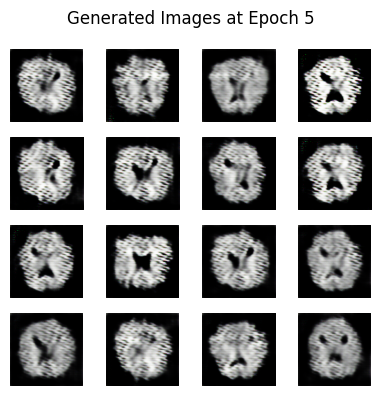

[Evaluation] FID: 21.21 | Precision: 0.074 | Recall: 0.057
[Evaluation] MMD: 0.0283 | 1-NN: 0.9990 | CID: {'creativity': np.float64(3.280275456751396), 'inheritance': np.float32(0.9731342), 'diversity': np.float64(3.910092280411853), 'cid_score': np.float64(7.217233517516795)}
Epoch 6, d_loss: 0.2199, g_loss: 1.7890, time: 14.16s
Epoch 7, d_loss: 0.1521, g_loss: 1.8205, time: 16.84s


2025-06-06 08:47:01.761626: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 8, d_loss: 0.1732, g_loss: 2.0387, time: 14.08s
Epoch 9, d_loss: 0.3802, g_loss: 1.4528, time: 16.98s
Epoch 10, d_loss: 0.3516, g_loss: 1.5924, time: 14.23s


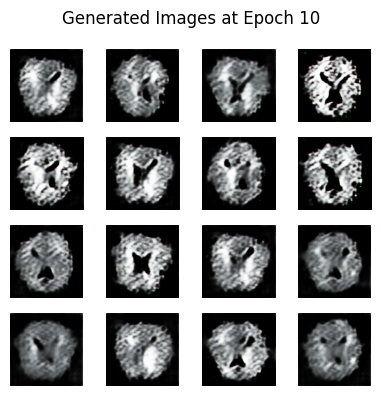

[Evaluation] FID: 20.91 | Precision: 0.312 | Recall: 0.143
[Evaluation] MMD: 0.0386 | 1-NN: 0.9961 | CID: {'creativity': np.float64(2.6636904853150063), 'inheritance': np.float32(0.98251605), 'diversity': np.float64(3.8111255654881293), 'cid_score': np.float64(6.4923000004643905)}
Epoch 11, d_loss: 0.1720, g_loss: 1.8246, time: 16.85s
Epoch 12, d_loss: 0.9386, g_loss: 0.2922, time: 14.15s
Epoch 13, d_loss: 0.2825, g_loss: 1.4521, time: 17.10s
Epoch 14, d_loss: 0.2826, g_loss: 1.4934, time: 14.26s
Epoch 15, d_loss: 0.4117, g_loss: 1.4562, time: 17.08s


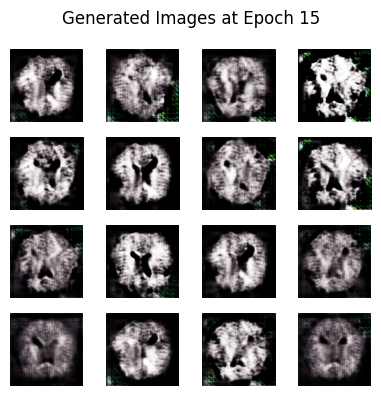

[Evaluation] FID: 26.53 | Precision: 0.283 | Recall: 0.121
[Evaluation] MMD: 0.0366 | 1-NN: 0.9980 | CID: {'creativity': np.float64(2.909045982708599), 'inheritance': np.float32(0.9786038), 'diversity': np.float64(3.808358806338747), 'cid_score': np.float64(6.738801008777723)}


2025-06-06 08:49:49.682340: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 16, d_loss: 0.1761, g_loss: 2.5110, time: 15.61s
Epoch 17, d_loss: 0.2839, g_loss: 1.2956, time: 15.50s
Epoch 18, d_loss: 0.3415, g_loss: 1.0391, time: 15.38s
Epoch 19, d_loss: 0.5313, g_loss: 1.3375, time: 15.36s
Epoch 20, d_loss: 0.5204, g_loss: 1.3890, time: 14.28s


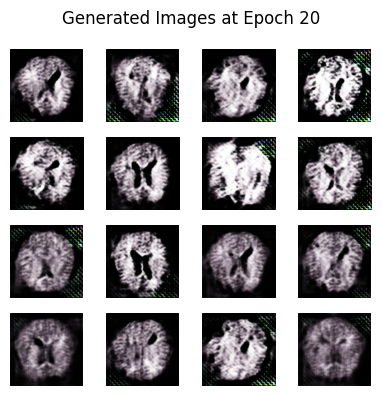

[Evaluation] FID: 22.04 | Precision: 0.207 | Recall: 0.117
[Evaluation] MMD: 0.0167 | 1-NN: 0.9961 | CID: {'creativity': np.float64(3.6586107715681226), 'inheritance': np.float32(0.96299034), 'diversity': np.float64(5.238958013393313), 'cid_score': np.float64(8.934578441390727)}
Epoch 21, d_loss: 0.2903, g_loss: 2.2225, time: 14.94s
Epoch 22, d_loss: 0.3919, g_loss: 1.2748, time: 16.08s
Epoch 23, d_loss: 0.2531, g_loss: 1.4384, time: 14.81s
Epoch 24, d_loss: 0.3031, g_loss: 1.9536, time: 14.36s
Epoch 25, d_loss: 0.2800, g_loss: 1.6118, time: 16.80s


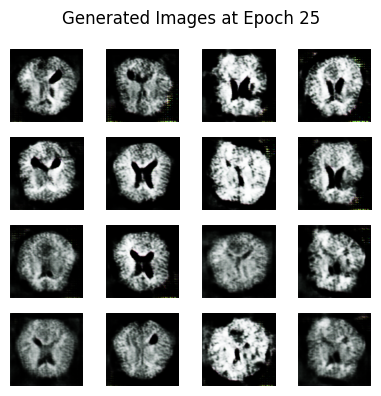

[Evaluation] FID: 16.88 | Precision: 0.484 | Recall: 0.164
[Evaluation] MMD: 0.0435 | 1-NN: 0.9844 | CID: {'creativity': np.float64(2.361971566554916), 'inheritance': np.float32(0.9858842), 'diversity': np.float64(3.894966096437855), 'cid_score': np.float64(6.271053473387058)}
Epoch 26, d_loss: 0.4214, g_loss: 1.2126, time: 16.68s
Epoch 27, d_loss: 0.3958, g_loss: 1.2898, time: 14.41s
Epoch 28, d_loss: 0.6251, g_loss: 0.5306, time: 16.92s
Epoch 29, d_loss: 0.4466, g_loss: 2.3457, time: 14.62s
Epoch 30, d_loss: 0.4905, g_loss: 1.7683, time: 16.54s


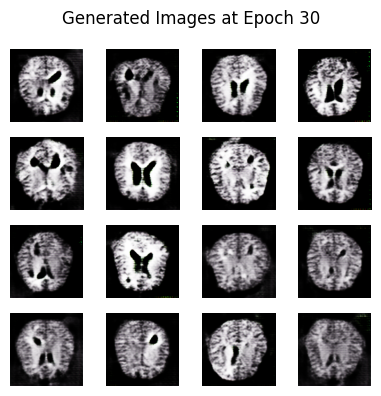

[Evaluation] FID: 10.90 | Precision: 0.332 | Recall: 0.209
[Evaluation] MMD: 0.0215 | 1-NN: 0.9805 | CID: {'creativity': np.float64(2.8095060055583314), 'inheritance': np.float32(0.97914875), 'diversity': np.float64(4.954812353157286), 'cid_score': np.float64(7.785169613178813)}
Epoch 31, d_loss: 0.3535, g_loss: 1.7241, time: 16.69s


2025-06-06 08:54:52.892053: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 32, d_loss: 0.4813, g_loss: 0.6417, time: 14.31s
Epoch 33, d_loss: 0.3697, g_loss: 1.3421, time: 16.74s
Epoch 34, d_loss: 0.3783, g_loss: 1.5826, time: 14.23s
Epoch 35, d_loss: 0.3079, g_loss: 1.2365, time: 14.71s


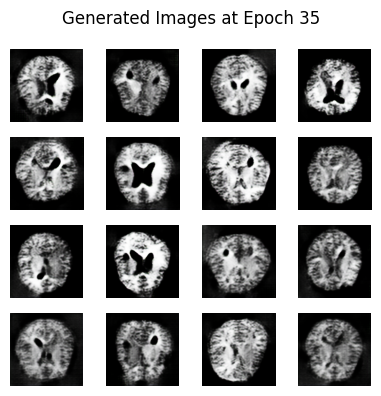

[Evaluation] FID: 8.63 | Precision: 0.434 | Recall: 0.254
[Evaluation] MMD: 0.0174 | 1-NN: 0.9580 | CID: {'creativity': np.float64(2.532023563362191), 'inheritance': np.float32(0.98315406), 'diversity': np.float64(4.621715699554364), 'cid_score': np.float64(7.170585204460133)}
Epoch 36, d_loss: 0.3315, g_loss: 1.3076, time: 14.16s
Epoch 37, d_loss: 0.4021, g_loss: 1.0047, time: 17.02s
Epoch 38, d_loss: 0.3536, g_loss: 2.2304, time: 14.14s
Epoch 39, d_loss: 0.4102, g_loss: 1.2175, time: 17.02s
Epoch 40, d_loss: 0.3120, g_loss: 1.3073, time: 14.30s


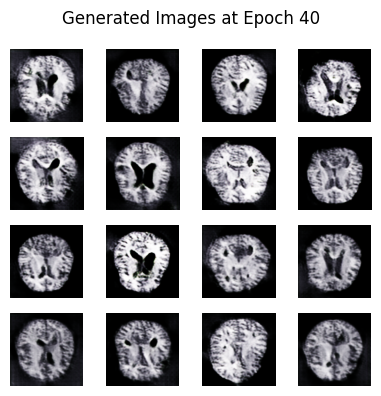

[Evaluation] FID: 7.38 | Precision: 0.387 | Recall: 0.285
[Evaluation] MMD: 0.0157 | 1-NN: 0.9639 | CID: {'creativity': np.float64(2.5176038295431145), 'inheritance': np.float32(0.9840949), 'diversity': np.float64(4.479958001671241), 'cid_score': np.float64(7.013466913440155)}
Epoch 41, d_loss: 0.3828, g_loss: 1.3492, time: 14.68s
Epoch 42, d_loss: 0.3550, g_loss: 1.4297, time: 16.47s
Epoch 43, d_loss: 0.3947, g_loss: 1.0744, time: 14.55s
Epoch 44, d_loss: 0.4575, g_loss: 1.7836, time: 14.66s
Epoch 45, d_loss: 0.4250, g_loss: 1.3656, time: 16.49s


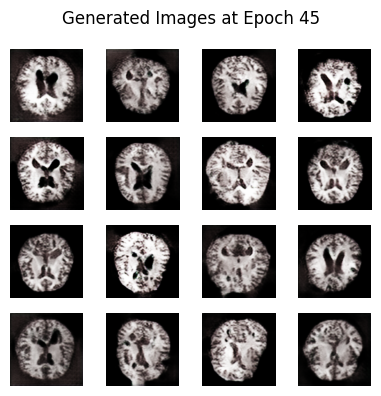

[Evaluation] FID: 8.19 | Precision: 0.402 | Recall: 0.318
[Evaluation] MMD: 0.0133 | 1-NN: 0.9492 | CID: {'creativity': np.float64(2.4290996419257453), 'inheritance': np.float32(0.9856385), 'diversity': np.float64(4.150184094454094), 'cid_score': np.float64(6.59364523711989)}
Epoch 46, d_loss: 0.3463, g_loss: 1.4818, time: 16.53s
Epoch 47, d_loss: 0.3882, g_loss: 1.0902, time: 14.49s
Epoch 48, d_loss: 0.5030, g_loss: 1.4610, time: 16.67s
Epoch 49, d_loss: 0.5397, g_loss: 2.1656, time: 14.56s
Epoch 50, d_loss: 0.4017, g_loss: 1.2947, time: 16.72s


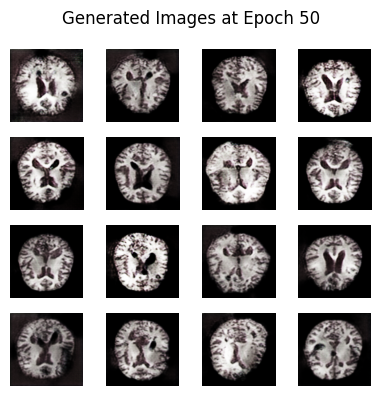

[Evaluation] FID: 6.02 | Precision: 0.461 | Recall: 0.342
[Evaluation] MMD: 0.0111 | 1-NN: 0.8809 | CID: {'creativity': np.float64(2.2819789004962656), 'inheritance': np.float32(0.9873458), 'diversity': np.float64(4.304145919816457), 'cid_score': np.float64(6.5987790056078275)}
Epoch 51, d_loss: 0.4282, g_loss: 1.2492, time: 14.52s
Epoch 52, d_loss: 0.3959, g_loss: 1.5429, time: 16.59s
Epoch 53, d_loss: 0.4067, g_loss: 1.7120, time: 14.56s
Epoch 54, d_loss: 0.5248, g_loss: 1.6348, time: 16.59s
Epoch 55, d_loss: 0.4269, g_loss: 1.1927, time: 14.41s


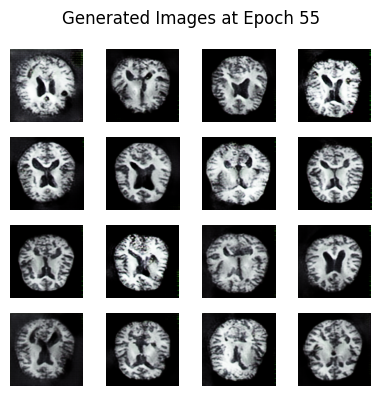

[Evaluation] FID: 6.76 | Precision: 0.373 | Recall: 0.344
[Evaluation] MMD: 0.0111 | 1-NN: 0.9199 | CID: {'creativity': np.float64(2.403786755399335), 'inheritance': np.float32(0.985973), 'diversity': np.float64(4.333383780743198), 'cid_score': np.float64(6.751197535616104)}
Epoch 56, d_loss: 0.5162, g_loss: 0.6604, time: 14.29s
Epoch 57, d_loss: 0.4052, g_loss: 1.3703, time: 16.92s
Epoch 58, d_loss: 0.5238, g_loss: 1.1562, time: 14.42s
Epoch 59, d_loss: 0.4270, g_loss: 0.9856, time: 14.50s
Epoch 60, d_loss: 0.5132, g_loss: 1.7431, time: 16.59s


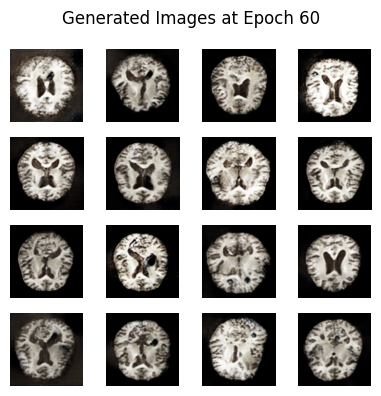

[Evaluation] FID: 4.99 | Precision: 0.445 | Recall: 0.381
[Evaluation] MMD: 0.0086 | 1-NN: 0.8350 | CID: {'creativity': np.float64(2.3312501644825243), 'inheritance': np.float32(0.9868875), 'diversity': np.float64(4.526975474201429), 'cid_score': np.float64(6.871338124092737)}
Epoch 61, d_loss: 0.4321, g_loss: 1.1943, time: 16.68s
Epoch 62, d_loss: 0.4444, g_loss: 0.9229, time: 14.54s
Epoch 63, d_loss: 0.4834, g_loss: 1.4315, time: 16.68s


2025-06-06 09:04:39.048600: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 64, d_loss: 0.5532, g_loss: 0.6167, time: 14.43s
Epoch 65, d_loss: 0.4966, g_loss: 0.8699, time: 16.81s


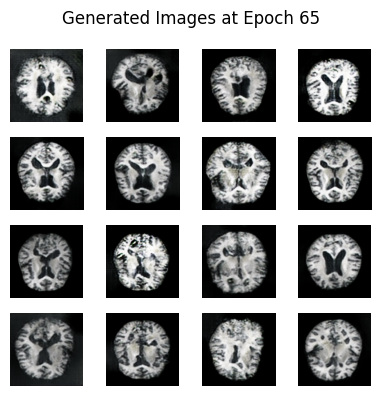

[Evaluation] FID: 6.08 | Precision: 0.562 | Recall: 0.404
[Evaluation] MMD: 0.0082 | 1-NN: 0.7959 | CID: {'creativity': np.float64(2.1148331209936533), 'inheritance': np.float32(0.989279), 'diversity': np.float64(4.203940404112163), 'cid_score': np.float64(6.329494552956921)}
Epoch 66, d_loss: 0.4243, g_loss: 1.2185, time: 14.28s
Epoch 67, d_loss: 0.5638, g_loss: 0.6616, time: 17.00s
Epoch 68, d_loss: 0.4022, g_loss: 1.2825, time: 14.14s
Epoch 69, d_loss: 0.5429, g_loss: 1.3975, time: 17.07s
Epoch 70, d_loss: 0.5572, g_loss: 0.5999, time: 14.20s


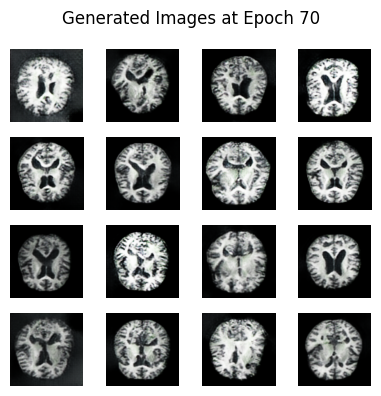

[Evaluation] FID: 3.54 | Precision: 0.432 | Recall: 0.400
[Evaluation] MMD: 0.0065 | 1-NN: 0.7959 | CID: {'creativity': np.float64(2.3049481643013396), 'inheritance': np.float32(0.9869914), 'diversity': np.float64(4.914505287246669), 'cid_score': np.float64(7.232462046060949)}
Epoch 71, d_loss: 0.4169, g_loss: 1.4059, time: 14.52s
Epoch 72, d_loss: 0.4891, g_loss: 0.7426, time: 14.18s
Epoch 73, d_loss: 0.5625, g_loss: 0.6818, time: 17.00s
Epoch 74, d_loss: 0.4817, g_loss: 0.9431, time: 14.16s
Epoch 75, d_loss: 0.4665, g_loss: 0.9589, time: 17.06s


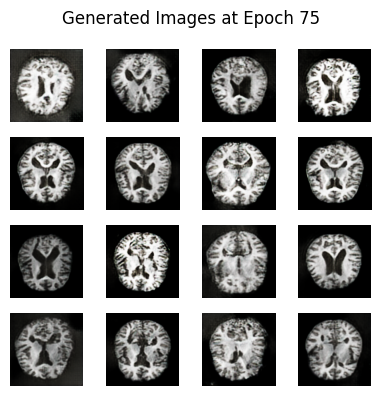

[Evaluation] FID: 3.59 | Precision: 0.408 | Recall: 0.371
[Evaluation] MMD: 0.0069 | 1-NN: 0.8086 | CID: {'creativity': np.float64(2.3376613671674766), 'inheritance': np.float32(0.9867035), 'diversity': np.float64(4.777940070559683), 'cid_score': np.float64(7.128897922674364)}
Epoch 76, d_loss: 0.5302, g_loss: 0.8495, time: 16.65s
Epoch 77, d_loss: 0.5153, g_loss: 0.9245, time: 14.39s
Epoch 78, d_loss: 0.5300, g_loss: 1.2020, time: 14.27s
Epoch 79, d_loss: 0.5198, g_loss: 0.8517, time: 16.92s
Epoch 80, d_loss: 0.5586, g_loss: 0.8671, time: 14.19s


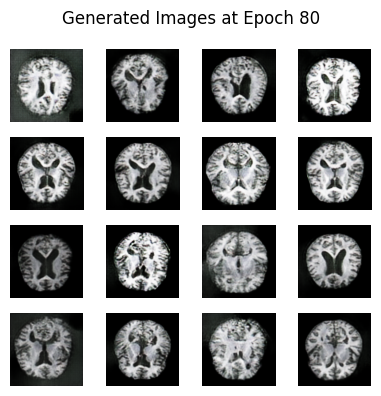

[Evaluation] FID: 3.52 | Precision: 0.525 | Recall: 0.420
[Evaluation] MMD: 0.0068 | 1-NN: 0.7422 | CID: {'creativity': np.float64(2.158735438098919), 'inheritance': np.float32(0.98857987), 'diversity': np.float64(4.690367833038556), 'cid_score': np.float64(6.86052340186715)}
Epoch 81, d_loss: 0.4038, g_loss: 1.1130, time: 14.42s
Epoch 82, d_loss: 0.5388, g_loss: 1.3127, time: 16.72s
Epoch 83, d_loss: 0.4719, g_loss: 1.0969, time: 14.40s
Epoch 84, d_loss: 0.4701, g_loss: 1.1694, time: 16.65s
Epoch 85, d_loss: 0.4477, g_loss: 1.6064, time: 14.41s


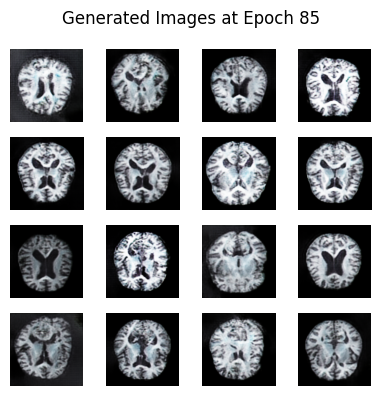

[Evaluation] FID: 2.34 | Precision: 0.393 | Recall: 0.410
[Evaluation] MMD: 0.0055 | 1-NN: 0.7285 | CID: {'creativity': np.float64(2.3487487397258544), 'inheritance': np.float32(0.9865147), 'diversity': np.float64(5.098460764298082), 'cid_score': np.float64(7.460694816485789)}
Epoch 86, d_loss: 0.5149, g_loss: 0.9784, time: 14.55s
Epoch 87, d_loss: 0.4697, g_loss: 1.4601, time: 14.48s
Epoch 88, d_loss: 0.3855, g_loss: 1.2115, time: 16.70s
Epoch 89, d_loss: 0.4952, g_loss: 1.1393, time: 14.42s
Epoch 90, d_loss: 0.5950, g_loss: 0.6419, time: 16.79s


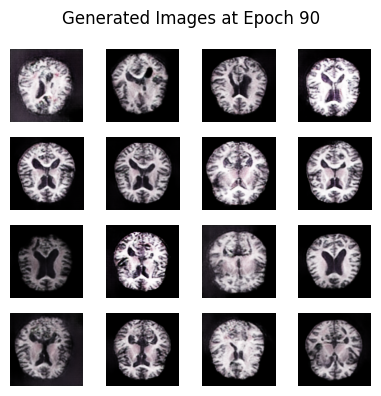

[Evaluation] FID: 3.91 | Precision: 0.557 | Recall: 0.449
[Evaluation] MMD: 0.0068 | 1-NN: 0.7520 | CID: {'creativity': np.float64(2.1200348174306574), 'inheritance': np.float32(0.9891634), 'diversity': np.float64(4.475411140899664), 'cid_score': np.float64(6.606282559587646)}
Epoch 91, d_loss: 0.5281, g_loss: 1.1676, time: 16.59s
Epoch 92, d_loss: 0.5072, g_loss: 1.2035, time: 14.49s
Epoch 93, d_loss: 0.5266, g_loss: 1.1193, time: 14.50s
Epoch 94, d_loss: 0.4434, g_loss: 1.7484, time: 16.70s
Epoch 95, d_loss: 0.5331, g_loss: 1.0765, time: 14.40s


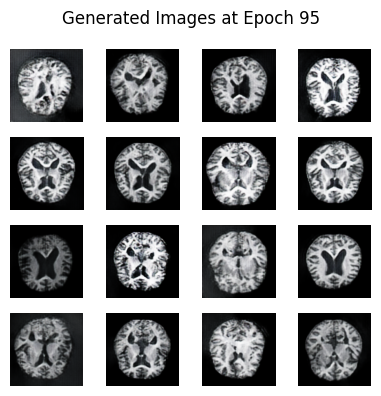

[Evaluation] FID: 3.04 | Precision: 0.461 | Recall: 0.391
[Evaluation] MMD: 0.0065 | 1-NN: 0.7930 | CID: {'creativity': np.float64(2.294286379888109), 'inheritance': np.float32(0.9869592), 'diversity': np.float64(5.021808866632522), 'cid_score': np.float64(7.329136027541749)}
Epoch 96, d_loss: 0.4473, g_loss: 1.0291, time: 14.36s
Epoch 97, d_loss: 0.3997, g_loss: 1.1593, time: 16.58s
Epoch 98, d_loss: 0.5291, g_loss: 1.0917, time: 14.43s
Epoch 99, d_loss: 0.4990, g_loss: 1.2909, time: 14.41s
Epoch 100, d_loss: 0.4828, g_loss: 0.8880, time: 16.64s


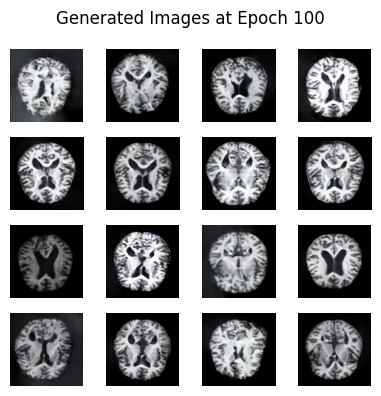

[Evaluation] FID: 2.54 | Precision: 0.459 | Recall: 0.443
[Evaluation] MMD: 0.0059 | 1-NN: 0.7441 | CID: {'creativity': np.float64(2.2538309361155493), 'inheritance': np.float32(0.9876354), 'diversity': np.float64(4.951601379780875), 'cid_score': np.float64(7.217796941827211)}
Epoch 101, d_loss: 0.5078, g_loss: 0.8023, time: 16.67s
Epoch 102, d_loss: 0.4647, g_loss: 1.3814, time: 14.36s
Epoch 103, d_loss: 0.5209, g_loss: 0.8976, time: 16.70s
Epoch 104, d_loss: 0.5356, g_loss: 0.9089, time: 14.32s
Epoch 105, d_loss: 0.5414, g_loss: 1.2137, time: 14.61s


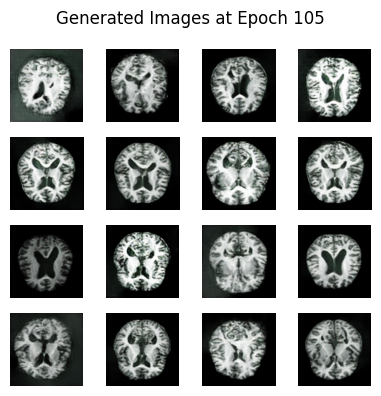

[Evaluation] FID: 2.97 | Precision: 0.529 | Recall: 0.434
[Evaluation] MMD: 0.0067 | 1-NN: 0.7705 | CID: {'creativity': np.float64(2.2044849008295717), 'inheritance': np.float32(0.9880915), 'diversity': np.float64(4.82672891672263), 'cid_score': np.float64(7.043122289136522)}
Epoch 106, d_loss: 0.4566, g_loss: 1.2783, time: 14.50s
Epoch 107, d_loss: 0.3601, g_loss: 1.5049, time: 16.63s
Epoch 108, d_loss: 0.5632, g_loss: 0.7640, time: 14.24s
Epoch 109, d_loss: 0.5384, g_loss: 0.6961, time: 16.99s
Epoch 110, d_loss: 0.5545, g_loss: 0.9156, time: 14.18s


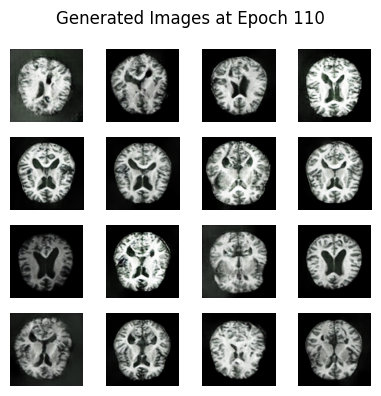

[Evaluation] FID: 3.42 | Precision: 0.564 | Recall: 0.438
[Evaluation] MMD: 0.0063 | 1-NN: 0.7080 | CID: {'creativity': np.float64(2.0736436409505035), 'inheritance': np.float32(0.9895717), 'diversity': np.float64(4.6886303243643175), 'cid_score': np.float64(6.772702274755433)}
Epoch 111, d_loss: 0.5078, g_loss: 0.9301, time: 16.81s
Epoch 112, d_loss: 0.6640, g_loss: 0.6615, time: 13.90s
Epoch 113, d_loss: 0.4998, g_loss: 1.1186, time: 17.46s
Epoch 114, d_loss: 0.5109, g_loss: 1.0218, time: 13.88s
Epoch 115, d_loss: 0.5012, g_loss: 1.1267, time: 17.15s


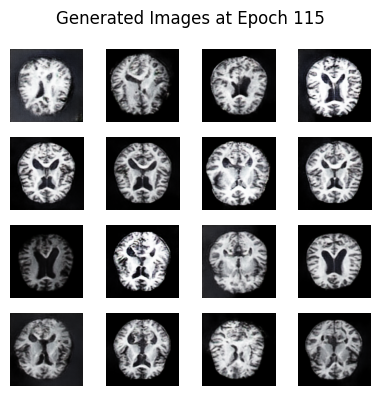

[Evaluation] FID: 2.12 | Precision: 0.463 | Recall: 0.416
[Evaluation] MMD: 0.0057 | 1-NN: 0.7549 | CID: {'creativity': np.float64(2.3263127865599156), 'inheritance': np.float32(0.9866129), 'diversity': np.float64(5.2322021349388015), 'cid_score': np.float64(7.57190200550598)}
Epoch 116, d_loss: 0.4371, g_loss: 1.3470, time: 16.59s
Epoch 117, d_loss: 0.4642, g_loss: 1.2768, time: 14.31s
Epoch 118, d_loss: 0.4776, g_loss: 1.0463, time: 14.28s
Epoch 119, d_loss: 0.5366, g_loss: 0.9469, time: 16.76s
Epoch 120, d_loss: 0.4861, g_loss: 1.2519, time: 14.34s


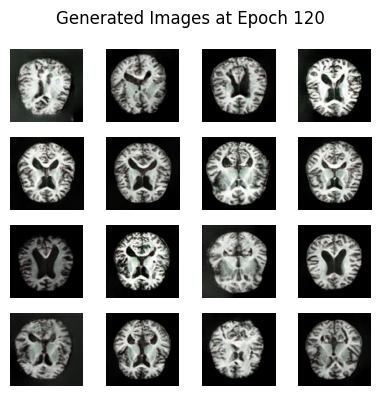

[Evaluation] FID: 3.05 | Precision: 0.471 | Recall: 0.443
[Evaluation] MMD: 0.0058 | 1-NN: 0.7373 | CID: {'creativity': np.float64(2.266784441439912), 'inheritance': np.float32(0.9874929), 'diversity': np.float64(4.82412119034945), 'cid_score': np.float64(7.103412712821161)}
Epoch 121, d_loss: 0.5047, g_loss: 1.2337, time: 14.30s
Epoch 122, d_loss: 0.5074, g_loss: 0.9795, time: 16.76s
Epoch 123, d_loss: 0.5422, g_loss: 1.3557, time: 14.33s
Epoch 124, d_loss: 0.4824, g_loss: 0.9237, time: 14.35s
Epoch 125, d_loss: 0.4475, g_loss: 0.9873, time: 16.74s


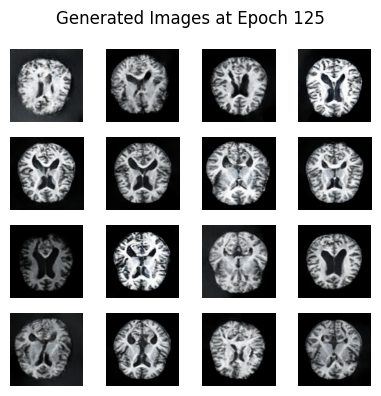

[Evaluation] FID: 3.06 | Precision: 0.486 | Recall: 0.439
[Evaluation] MMD: 0.0063 | 1-NN: 0.7471 | CID: {'creativity': np.float64(2.261994540199084), 'inheritance': np.float32(0.98735183), 'diversity': np.float64(4.970382487116884), 'cid_score': np.float64(7.24502519254195)}
Epoch 126, d_loss: 0.5912, g_loss: 1.3848, time: 16.82s
Epoch 127, d_loss: 0.4999, g_loss: 0.9902, time: 14.25s


2025-06-06 09:23:52.996846: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 128, d_loss: 0.5702, g_loss: 1.0086, time: 16.88s
Epoch 129, d_loss: 0.5120, g_loss: 0.8343, time: 14.18s
Epoch 130, d_loss: 0.5698, g_loss: 1.1991, time: 14.33s


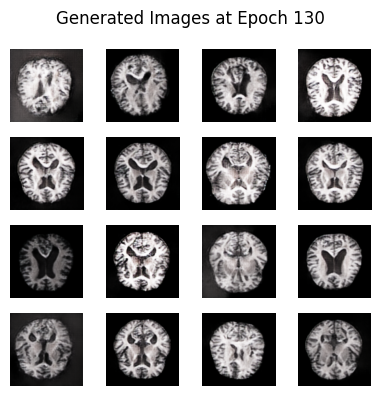

[Evaluation] FID: 3.28 | Precision: 0.543 | Recall: 0.436
[Evaluation] MMD: 0.0063 | 1-NN: 0.7480 | CID: {'creativity': np.float64(2.1346763285744506), 'inheritance': np.float32(0.98897606), 'diversity': np.float64(4.603896040517442), 'cid_score': np.float64(6.749596307747746)}
Epoch 131, d_loss: 0.6027, g_loss: 1.1132, time: 13.94s
Epoch 132, d_loss: 0.5333, g_loss: 1.0435, time: 17.15s
Epoch 133, d_loss: 0.4751, g_loss: 1.3363, time: 13.99s
Epoch 134, d_loss: 0.5125, g_loss: 1.0224, time: 17.13s
Epoch 135, d_loss: 0.5104, g_loss: 0.8501, time: 14.18s


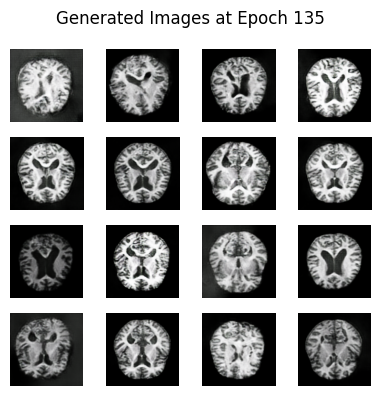

[Evaluation] FID: 4.10 | Precision: 0.590 | Recall: 0.467
[Evaluation] MMD: 0.0071 | 1-NN: 0.7129 | CID: {'creativity': np.float64(2.087110246970235), 'inheritance': np.float32(0.9896409), 'diversity': np.float64(4.39271653359905), 'cid_score': np.float64(6.490185889017313)}
Epoch 136, d_loss: 0.5950, g_loss: 0.7524, time: 17.25s
Epoch 137, d_loss: 0.4428, g_loss: 1.3169, time: 14.00s
Epoch 138, d_loss: 0.4769, g_loss: 1.1171, time: 17.12s
Epoch 139, d_loss: 0.5855, g_loss: 1.0088, time: 13.86s
Epoch 140, d_loss: 0.5301, g_loss: 1.5353, time: 17.23s


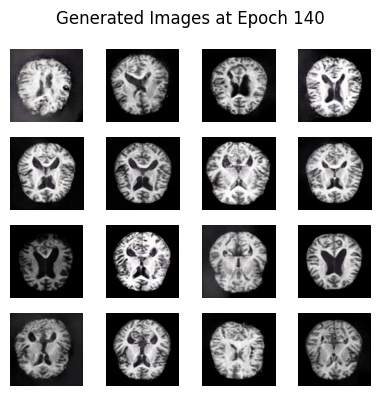

[Evaluation] FID: 3.83 | Precision: 0.627 | Recall: 0.438
[Evaluation] MMD: 0.0066 | 1-NN: 0.7148 | CID: {'creativity': np.float64(2.0432213191585804), 'inheritance': np.float32(0.98983186), 'diversity': np.float64(4.547342197051036), 'cid_score': np.float64(6.600731651375785)}
Epoch 141, d_loss: 0.5060, g_loss: 0.9636, time: 14.15s
Epoch 142, d_loss: 0.4515, g_loss: 1.3367, time: 17.13s
Epoch 143, d_loss: 0.4485, g_loss: 1.0377, time: 14.04s
Epoch 144, d_loss: 0.4811, g_loss: 1.2799, time: 17.43s
Epoch 145, d_loss: 0.4034, g_loss: 1.3316, time: 14.07s


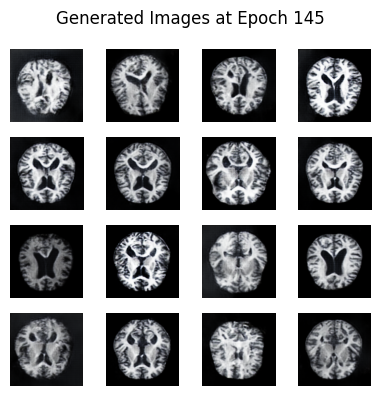

[Evaluation] FID: 5.51 | Precision: 0.555 | Recall: 0.414
[Evaluation] MMD: 0.0074 | 1-NN: 0.7695 | CID: {'creativity': np.float64(2.111485307244214), 'inheritance': np.float32(0.9892404), 'diversity': np.float64(4.500139991933031), 'cid_score': np.float64(6.622384891233519)}
Epoch 146, d_loss: 0.5236, g_loss: 0.9631, time: 14.21s
Epoch 147, d_loss: 0.4940, g_loss: 1.1175, time: 14.07s
Epoch 148, d_loss: 0.4988, g_loss: 1.1154, time: 17.24s
Epoch 149, d_loss: 0.5455, g_loss: 0.7995, time: 13.99s
Epoch 150, d_loss: 0.5799, g_loss: 0.7404, time: 17.33s


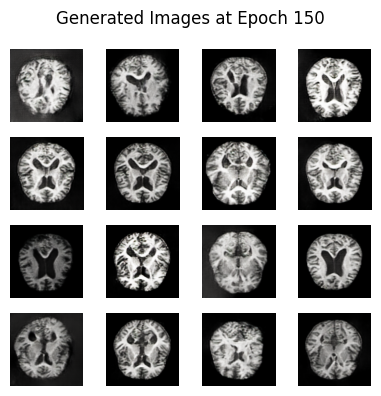

[Evaluation] FID: 4.69 | Precision: 0.643 | Recall: 0.430
[Evaluation] MMD: 0.0067 | 1-NN: 0.7422 | CID: {'creativity': np.float64(2.0319931953341817), 'inheritance': np.float32(0.990002), 'diversity': np.float64(4.347640274603057), 'cid_score': np.float64(6.389631493447218)}
Epoch 151, d_loss: 0.4683, g_loss: 1.1489, time: 14.09s
Epoch 152, d_loss: 0.5024, g_loss: 1.3587, time: 17.14s
Epoch 153, d_loss: 0.5078, g_loss: 0.7978, time: 13.94s
Epoch 154, d_loss: 0.4749, g_loss: 0.9398, time: 17.38s
Epoch 155, d_loss: 0.6167, g_loss: 1.1342, time: 13.87s


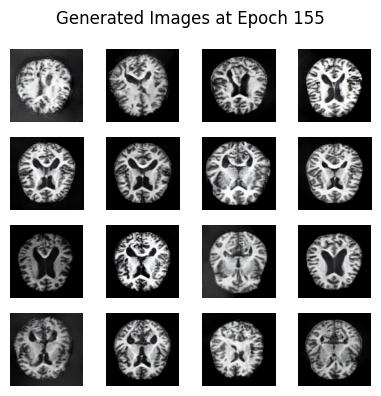

[Evaluation] FID: 3.44 | Precision: 0.381 | Recall: 0.418
[Evaluation] MMD: 0.0064 | 1-NN: 0.7695 | CID: {'creativity': np.float64(2.3816842172244743), 'inheritance': np.float32(0.9860678), 'diversity': np.float64(5.142931743243987), 'cid_score': np.float64(7.53854818855684)}
Epoch 156, d_loss: 0.4932, g_loss: 1.0175, time: 13.96s
Epoch 157, d_loss: 0.4518, g_loss: 1.2901, time: 16.96s
Epoch 158, d_loss: 0.4618, g_loss: 1.2254, time: 14.23s
Epoch 159, d_loss: 0.5482, g_loss: 0.9675, time: 13.87s
Epoch 160, d_loss: 0.5419, g_loss: 1.4195, time: 17.68s


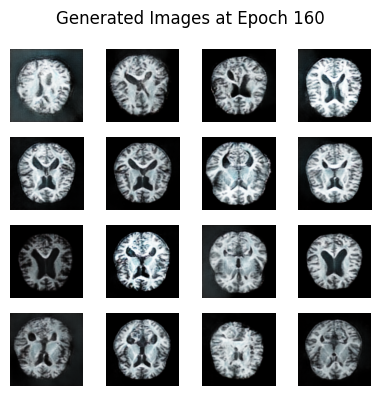

[Evaluation] FID: 3.60 | Precision: 0.570 | Recall: 0.443
[Evaluation] MMD: 0.0063 | 1-NN: 0.7217 | CID: {'creativity': np.float64(2.090235943812343), 'inheritance': np.float32(0.98943794), 'diversity': np.float64(4.473331904367927), 'cid_score': np.float64(6.574129910443759)}
Epoch 161, d_loss: 0.4885, g_loss: 0.9531, time: 16.33s
Epoch 162, d_loss: 0.5642, g_loss: 1.5072, time: 13.86s
Epoch 163, d_loss: 0.5093, g_loss: 0.9665, time: 17.25s
Epoch 164, d_loss: 0.4830, g_loss: 0.9587, time: 13.98s
Epoch 165, d_loss: 0.5106, g_loss: 0.9930, time: 14.00s


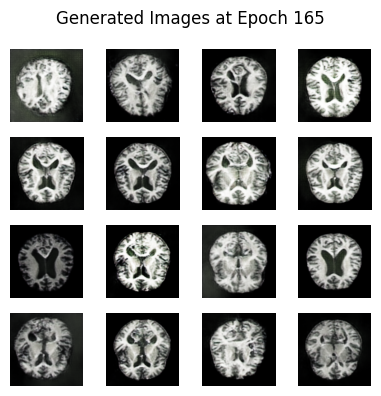

[Evaluation] FID: 2.75 | Precision: 0.590 | Recall: 0.467
[Evaluation] MMD: 0.0060 | 1-NN: 0.7295 | CID: {'creativity': np.float64(2.10094026153505), 'inheritance': np.float32(0.98934966), 'diversity': np.float64(4.6849807435393185), 'cid_score': np.float64(6.79657134181677)}
Epoch 166, d_loss: 0.5213, g_loss: 0.8253, time: 14.08s
Epoch 167, d_loss: 0.5364, g_loss: 1.4313, time: 17.17s
Epoch 168, d_loss: 0.5345, g_loss: 0.9834, time: 14.12s
Epoch 169, d_loss: 0.4822, g_loss: 0.9436, time: 17.15s
Epoch 170, d_loss: 0.4999, g_loss: 0.9331, time: 14.15s


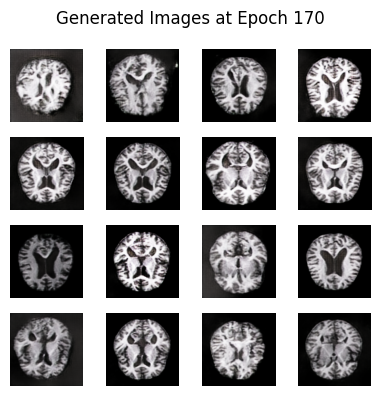

[Evaluation] FID: 2.70 | Precision: 0.432 | Recall: 0.436
[Evaluation] MMD: 0.0060 | 1-NN: 0.7275 | CID: {'creativity': np.float64(2.3092676917929955), 'inheritance': np.float32(0.98699164), 'diversity': np.float64(4.836459914073798), 'cid_score': np.float64(7.1587359619611535)}
Epoch 171, d_loss: 0.4861, g_loss: 1.2057, time: 17.12s
Epoch 172, d_loss: 0.5117, g_loss: 1.0075, time: 14.03s
Epoch 173, d_loss: 0.4982, g_loss: 1.3485, time: 17.14s
Epoch 174, d_loss: 0.4876, g_loss: 1.2623, time: 14.10s
Epoch 175, d_loss: 0.5086, g_loss: 1.2832, time: 17.13s


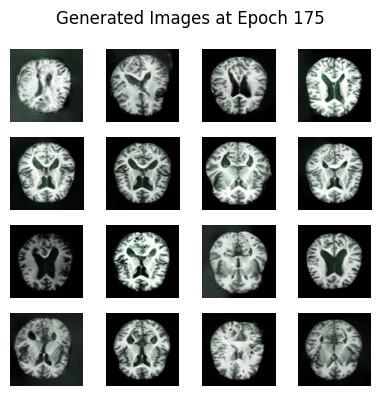

[Evaluation] FID: 2.41 | Precision: 0.541 | Recall: 0.418
[Evaluation] MMD: 0.0054 | 1-NN: 0.7422 | CID: {'creativity': np.float64(2.1950024692522714), 'inheritance': np.float32(0.9879803), 'diversity': np.float64(4.983749776566891), 'cid_score': np.float64(7.1907719396706336)}
Epoch 176, d_loss: 0.5120, g_loss: 1.0740, time: 14.06s
Epoch 177, d_loss: 0.4839, g_loss: 0.9942, time: 17.17s
Epoch 178, d_loss: 0.5077, g_loss: 1.2229, time: 14.01s
Epoch 179, d_loss: 0.5292, g_loss: 1.6408, time: 17.12s
Epoch 180, d_loss: 0.4213, g_loss: 1.4445, time: 14.11s


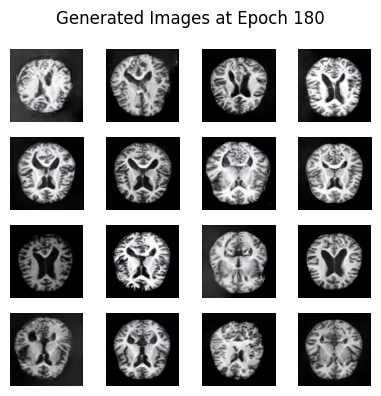

[Evaluation] FID: 2.47 | Precision: 0.518 | Recall: 0.414
[Evaluation] MMD: 0.0055 | 1-NN: 0.6992 | CID: {'creativity': np.float64(2.216533752868349), 'inheritance': np.float32(0.9878262), 'diversity': np.float64(5.009245076401282), 'cid_score': np.float64(7.237952601127846)}
Epoch 181, d_loss: 0.5181, g_loss: 1.2873, time: 14.15s
Epoch 182, d_loss: 0.6070, g_loss: 0.7531, time: 14.05s
Epoch 183, d_loss: 0.5029, g_loss: 0.7895, time: 17.20s
Epoch 184, d_loss: 0.4971, g_loss: 1.3286, time: 14.08s
Epoch 185, d_loss: 0.4691, g_loss: 0.9883, time: 17.12s


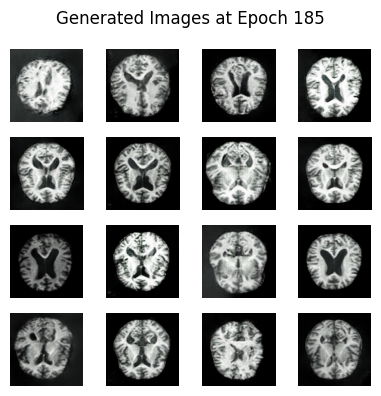

[Evaluation] FID: 5.25 | Precision: 0.664 | Recall: 0.449
[Evaluation] MMD: 0.0067 | 1-NN: 0.7373 | CID: {'creativity': np.float64(1.984662272022275), 'inheritance': np.float32(0.9905309), 'diversity': np.float64(4.229701860143203), 'cid_score': np.float64(6.223833224057721)}
Epoch 186, d_loss: 0.5262, g_loss: 1.0193, time: 17.13s
Epoch 187, d_loss: 0.5015, g_loss: 1.1404, time: 14.15s
Epoch 188, d_loss: 0.5456, g_loss: 1.4708, time: 14.08s
Epoch 189, d_loss: 0.5135, g_loss: 1.0979, time: 17.19s
Epoch 190, d_loss: 0.5227, g_loss: 1.1411, time: 14.09s


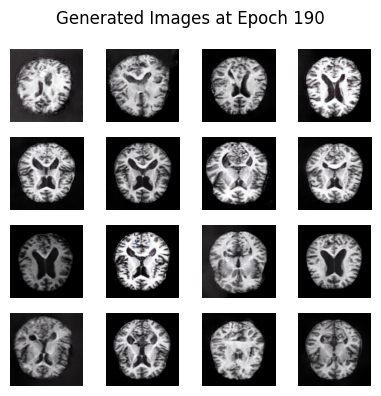

[Evaluation] FID: 3.89 | Precision: 0.629 | Recall: 0.422
[Evaluation] MMD: 0.0074 | 1-NN: 0.7217 | CID: {'creativity': np.float64(2.041469307271786), 'inheritance': np.float32(0.98972297), 'diversity': np.float64(4.668207859925375), 'cid_score': np.float64(6.719954200049334)}
Epoch 191, d_loss: 0.5124, g_loss: 1.0159, time: 13.97s
Epoch 192, d_loss: 0.5387, g_loss: 0.8834, time: 17.19s
Epoch 193, d_loss: 0.5097, g_loss: 1.2871, time: 14.21s
Epoch 194, d_loss: 0.5038, g_loss: 0.8890, time: 14.09s
Epoch 195, d_loss: 0.5170, g_loss: 1.8414, time: 17.41s


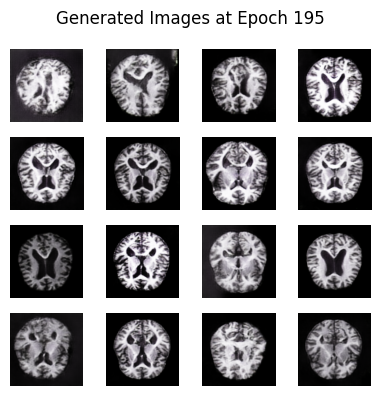

[Evaluation] FID: 2.70 | Precision: 0.521 | Recall: 0.457
[Evaluation] MMD: 0.0057 | 1-NN: 0.7002 | CID: {'creativity': np.float64(2.214104603549768), 'inheritance': np.float32(0.9879863), 'diversity': np.float64(5.047264358972749), 'cid_score': np.float64(7.273382636304865)}
Epoch 196, d_loss: 0.4956, g_loss: 1.3236, time: 17.09s
Epoch 197, d_loss: 0.4999, g_loss: 0.8771, time: 14.05s
Epoch 198, d_loss: 0.5453, g_loss: 0.9486, time: 17.20s
Epoch 199, d_loss: 0.5055, g_loss: 1.1672, time: 14.18s
Epoch 200, d_loss: 0.4908, g_loss: 0.9155, time: 13.93s


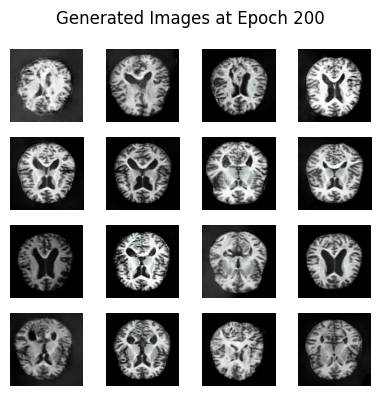

[Evaluation] FID: 4.20 | Precision: 0.598 | Recall: 0.430
[Evaluation] MMD: 0.0064 | 1-NN: 0.7354 | CID: {'creativity': np.float64(2.129731906051051), 'inheritance': np.float32(0.98887974), 'diversity': np.float64(4.67303103822158), 'cid_score': np.float64(6.8138832040344415)}
Epoch 201, d_loss: 0.4418, g_loss: 1.3529, time: 14.12s
Epoch 202, d_loss: 0.4949, g_loss: 1.1030, time: 17.21s
Epoch 203, d_loss: 0.4551, g_loss: 1.0171, time: 13.95s
Epoch 204, d_loss: 0.5272, g_loss: 1.0562, time: 17.31s
Epoch 205, d_loss: 0.5494, g_loss: 1.0350, time: 14.05s


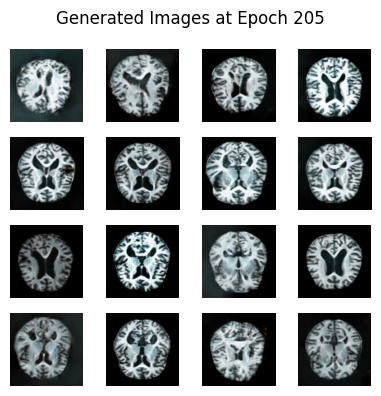

[Evaluation] FID: 4.16 | Precision: 0.299 | Recall: 0.383
[Evaluation] MMD: 0.0057 | 1-NN: 0.7676 | CID: {'creativity': np.float64(2.6932321145897222), 'inheritance': np.float32(0.9817795), 'diversity': np.float64(6.024100175203812), 'cid_score': np.float64(8.735552774050278)}
Epoch 206, d_loss: 0.5088, g_loss: 0.8952, time: 17.49s
Epoch 207, d_loss: 0.5255, g_loss: 1.2241, time: 13.95s
Epoch 208, d_loss: 0.5339, g_loss: 1.1594, time: 17.16s
Epoch 209, d_loss: 0.6308, g_loss: 1.0196, time: 14.17s
Epoch 210, d_loss: 0.5653, g_loss: 1.0204, time: 13.94s


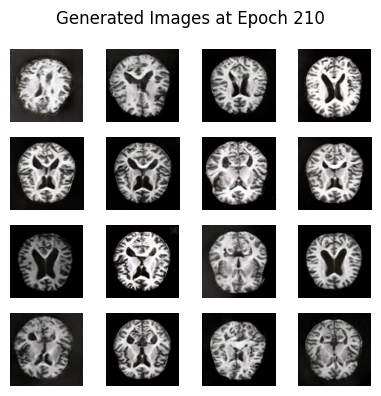

[Evaluation] FID: 2.43 | Precision: 0.391 | Recall: 0.410
[Evaluation] MMD: 0.0056 | 1-NN: 0.7598 | CID: {'creativity': np.float64(2.4620569327409676), 'inheritance': np.float32(0.9848459), 'diversity': np.float64(5.657971381218941), 'cid_score': np.float64(8.135182437266183)}
Epoch 211, d_loss: 0.5283, g_loss: 0.9526, time: 13.91s
Epoch 212, d_loss: 0.5826, g_loss: 0.7760, time: 16.70s
Epoch 213, d_loss: 0.5402, g_loss: 1.0181, time: 13.89s
Epoch 214, d_loss: 0.4754, g_loss: 0.8884, time: 17.51s
Epoch 215, d_loss: 0.4820, g_loss: 1.0631, time: 14.02s


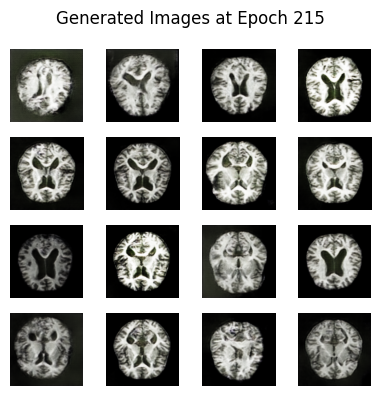

[Evaluation] FID: 4.30 | Precision: 0.613 | Recall: 0.420
[Evaluation] MMD: 0.0064 | 1-NN: 0.7412 | CID: {'creativity': np.float64(2.0528697117066494), 'inheritance': np.float32(0.9897516), 'diversity': np.float64(4.624835872965977), 'cid_score': np.float64(6.687954007295307)}
Epoch 216, d_loss: 0.6049, g_loss: 0.8074, time: 17.27s
Epoch 217, d_loss: 0.5507, g_loss: 1.0523, time: 13.91s
Epoch 218, d_loss: 0.5583, g_loss: 1.3152, time: 17.43s
Epoch 219, d_loss: 0.5853, g_loss: 0.8723, time: 13.92s
Epoch 220, d_loss: 0.5556, g_loss: 0.8104, time: 17.13s


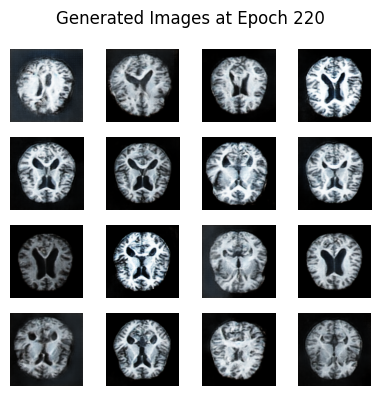

[Evaluation] FID: 4.56 | Precision: 0.604 | Recall: 0.385
[Evaluation] MMD: 0.0088 | 1-NN: 0.7646 | CID: {'creativity': np.float64(2.1097573468091726), 'inheritance': np.float32(0.98886544), 'diversity': np.float64(4.741546090054534), 'cid_score': np.float64(6.862438001740263)}
Epoch 221, d_loss: 0.4745, g_loss: 0.9758, time: 14.08s
Epoch 222, d_loss: 0.5273, g_loss: 0.7440, time: 17.09s
Epoch 223, d_loss: 0.6049, g_loss: 0.9995, time: 14.20s
Epoch 224, d_loss: 0.6039, g_loss: 0.8998, time: 16.99s
Epoch 225, d_loss: 0.4911, g_loss: 0.9340, time: 14.19s


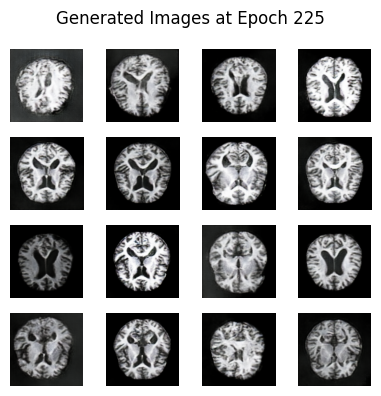

[Evaluation] FID: 2.08 | Precision: 0.510 | Recall: 0.447
[Evaluation] MMD: 0.0054 | 1-NN: 0.7080 | CID: {'creativity': np.float64(2.22280694600079), 'inheritance': np.float32(0.9878142), 'diversity': np.float64(5.084148588823973), 'cid_score': np.float64(7.3191413468212225)}
Epoch 226, d_loss: 0.5438, g_loss: 0.7723, time: 14.26s
Epoch 227, d_loss: 0.5118, g_loss: 0.8563, time: 14.21s
Epoch 228, d_loss: 0.5141, g_loss: 0.9951, time: 17.02s
Epoch 229, d_loss: 0.5531, g_loss: 1.1385, time: 14.20s
Epoch 230, d_loss: 0.6817, g_loss: 0.7199, time: 17.03s


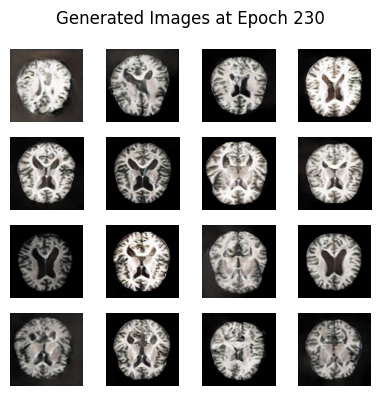

[Evaluation] FID: 3.05 | Precision: 0.500 | Recall: 0.410
[Evaluation] MMD: 0.0058 | 1-NN: 0.7529 | CID: {'creativity': np.float64(2.2165385227114776), 'inheritance': np.float32(0.9879267), 'diversity': np.float64(4.865037926221053), 'cid_score': np.float64(7.093649727359654)}
Epoch 231, d_loss: 0.5441, g_loss: 1.1632, time: 14.14s
Epoch 232, d_loss: 0.5188, g_loss: 1.1568, time: 17.00s
Epoch 233, d_loss: 0.4535, g_loss: 1.3588, time: 14.14s
Epoch 234, d_loss: 0.5860, g_loss: 1.0585, time: 17.00s
Epoch 235, d_loss: 0.5328, g_loss: 1.2318, time: 14.18s


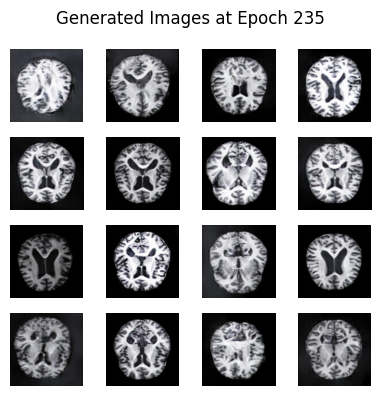

[Evaluation] FID: 2.10 | Precision: 0.414 | Recall: 0.408
[Evaluation] MMD: 0.0055 | 1-NN: 0.7139 | CID: {'creativity': np.float64(2.3766712257015365), 'inheritance': np.float32(0.9860078), 'diversity': np.float64(5.443901911749988), 'cid_score': np.float64(7.834565327812547)}
Epoch 236, d_loss: 0.5602, g_loss: 1.2261, time: 14.22s
Epoch 237, d_loss: 0.5666, g_loss: 1.3789, time: 14.17s
Epoch 238, d_loss: 0.6466, g_loss: 0.9427, time: 16.99s
Epoch 239, d_loss: 0.5495, g_loss: 1.3214, time: 14.08s
Epoch 240, d_loss: 0.5119, g_loss: 1.0169, time: 17.02s


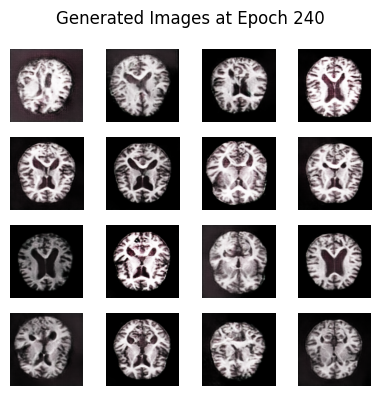

[Evaluation] FID: 2.61 | Precision: 0.375 | Recall: 0.414
[Evaluation] MMD: 0.0070 | 1-NN: 0.7637 | CID: {'creativity': np.float64(2.424975447146352), 'inheritance': np.float32(0.98534334), 'diversity': np.float64(5.183922506951062), 'cid_score': np.float64(7.623554617038393)}
Epoch 241, d_loss: 0.5918, g_loss: 1.3660, time: 14.09s
Epoch 242, d_loss: 0.4978, g_loss: 0.9204, time: 17.19s
Epoch 243, d_loss: 0.5259, g_loss: 0.8519, time: 14.05s
Epoch 244, d_loss: 0.5493, g_loss: 1.3141, time: 17.04s
Epoch 245, d_loss: 0.5525, g_loss: 0.6885, time: 13.92s


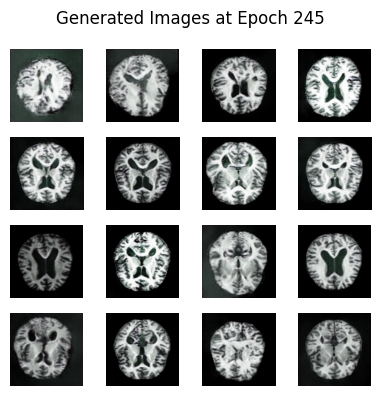

[Evaluation] FID: 2.59 | Precision: 0.531 | Recall: 0.455
[Evaluation] MMD: 0.0054 | 1-NN: 0.7090 | CID: {'creativity': np.float64(2.1670579683866733), 'inheritance': np.float32(0.9885211), 'diversity': np.float64(4.830857579658243), 'cid_score': np.float64(7.009394448954341)}
Epoch 246, d_loss: 0.5515, g_loss: 1.0236, time: 14.59s
Epoch 247, d_loss: 0.5316, g_loss: 1.1940, time: 16.53s
Epoch 248, d_loss: 0.5663, g_loss: 0.7612, time: 14.08s
Epoch 249, d_loss: 0.4656, g_loss: 0.9820, time: 13.92s
Epoch 250, d_loss: 0.4927, g_loss: 1.4533, time: 17.49s


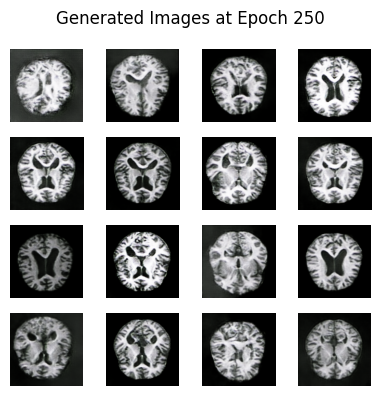

[Evaluation] FID: 2.42 | Precision: 0.461 | Recall: 0.424
[Evaluation] MMD: 0.0053 | 1-NN: 0.7168 | CID: {'creativity': np.float64(2.2619301895093114), 'inheritance': np.float32(0.9874351), 'diversity': np.float64(4.971867818782517), 'cid_score': np.float64(7.246362905829059)}
Epoch 251, d_loss: 0.5120, g_loss: 1.1421, time: 17.01s
Epoch 252, d_loss: 0.4748, g_loss: 1.3824, time: 14.04s
Epoch 253, d_loss: 0.4858, g_loss: 1.1029, time: 14.24s
Epoch 254, d_loss: 0.5021, g_loss: 1.1336, time: 17.00s
Epoch 255, d_loss: 0.6032, g_loss: 1.2674, time: 14.17s


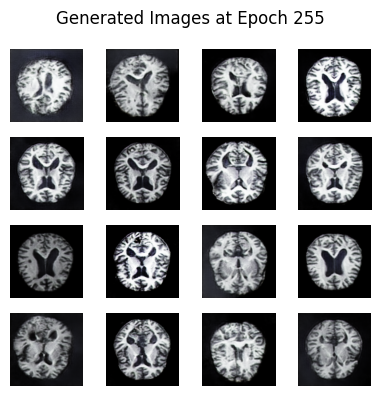

[Evaluation] FID: 2.24 | Precision: 0.395 | Recall: 0.432
[Evaluation] MMD: 0.0054 | 1-NN: 0.7197 | CID: {'creativity': np.float64(2.3594864786700924), 'inheritance': np.float32(0.9862274), 'diversity': np.float64(5.189259620619004), 'cid_score': np.float64(7.562518706138767)}


2025-06-06 10:02:14.555996: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 256, d_loss: 0.4871, g_loss: 0.9783, time: 14.09s
Epoch 257, d_loss: 0.5254, g_loss: 1.1745, time: 17.11s
Epoch 258, d_loss: 0.5395, g_loss: 1.1393, time: 14.02s
Epoch 259, d_loss: 0.4797, g_loss: 1.1141, time: 14.25s
Epoch 260, d_loss: 0.5181, g_loss: 1.0505, time: 16.93s


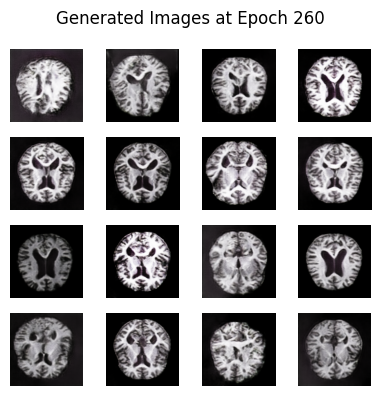

[Evaluation] FID: 2.45 | Precision: 0.480 | Recall: 0.391
[Evaluation] MMD: 0.0061 | 1-NN: 0.7363 | CID: {'creativity': np.float64(2.2829762719761977), 'inheritance': np.float32(0.98701763), 'diversity': np.float64(5.242471755225246), 'cid_score': np.float64(7.538430395670682)}
Epoch 261, d_loss: 0.5007, g_loss: 1.3088, time: 17.14s
Epoch 262, d_loss: 0.5533, g_loss: 0.9275, time: 14.05s
Epoch 263, d_loss: 0.5996, g_loss: 1.1286, time: 17.15s
Epoch 264, d_loss: 0.5520, g_loss: 0.9318, time: 14.20s
Epoch 265, d_loss: 0.5318, g_loss: 1.0766, time: 14.05s


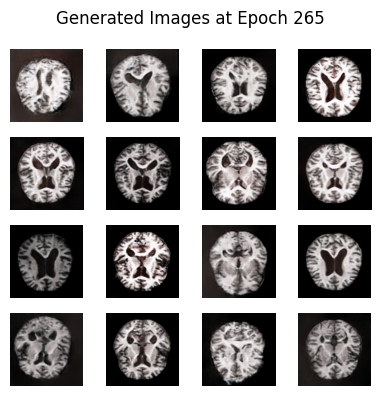

[Evaluation] FID: 2.15 | Precision: 0.486 | Recall: 0.430
[Evaluation] MMD: 0.0054 | 1-NN: 0.6885 | CID: {'creativity': np.float64(2.2402732236211436), 'inheritance': np.float32(0.98738956), 'diversity': np.float64(5.052235531605119), 'cid_score': np.float64(7.305119190712102)}
Epoch 266, d_loss: 0.5645, g_loss: 0.6505, time: 13.86s
Epoch 267, d_loss: 0.5084, g_loss: 1.0676, time: 17.35s
Epoch 268, d_loss: 0.5687, g_loss: 1.0391, time: 13.99s
Epoch 269, d_loss: 0.4274, g_loss: 1.2174, time: 17.21s
Epoch 270, d_loss: 0.5714, g_loss: 0.7156, time: 14.20s


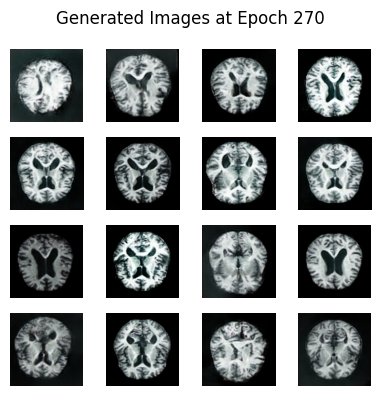

[Evaluation] FID: 2.70 | Precision: 0.516 | Recall: 0.430
[Evaluation] MMD: 0.0056 | 1-NN: 0.7441 | CID: {'creativity': np.float64(2.180434513764694), 'inheritance': np.float32(0.9882785), 'diversity': np.float64(4.855306080741405), 'cid_score': np.float64(7.047462086319759)}
Epoch 271, d_loss: 0.5828, g_loss: 1.3537, time: 17.32s
Epoch 272, d_loss: 0.6078, g_loss: 1.3579, time: 13.85s
Epoch 273, d_loss: 0.5696, g_loss: 1.0999, time: 17.64s
Epoch 274, d_loss: 0.6014, g_loss: 0.9247, time: 14.31s
Epoch 275, d_loss: 0.5543, g_loss: 1.4356, time: 16.37s


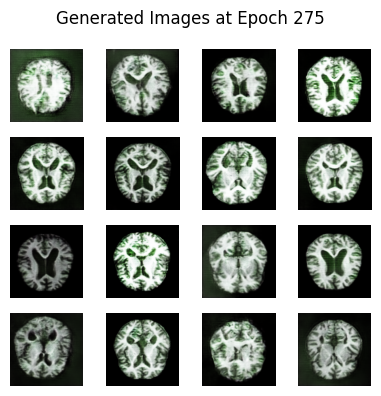

[Evaluation] FID: 5.49 | Precision: 0.678 | Recall: 0.461
[Evaluation] MMD: 0.0083 | 1-NN: 0.7256 | CID: {'creativity': np.float64(1.99699251891613), 'inheritance': np.float32(0.9904625), 'diversity': np.float64(4.214134252881797), 'cid_score': np.float64(6.220664289822372)}
Epoch 276, d_loss: 0.6425, g_loss: 0.8503, time: 14.03s
Epoch 277, d_loss: 0.6032, g_loss: 1.6639, time: 17.88s
Epoch 278, d_loss: 0.5482, g_loss: 1.0576, time: 13.95s
Epoch 279, d_loss: 0.5509, g_loss: 0.9072, time: 16.70s
Epoch 280, d_loss: 0.6339, g_loss: 0.8498, time: 13.95s


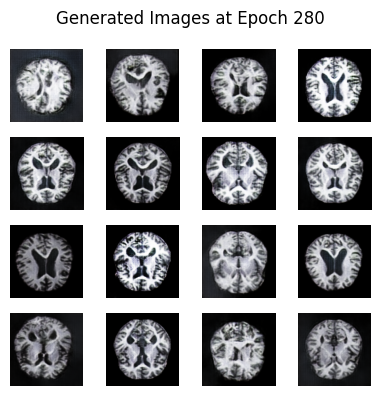

[Evaluation] FID: 2.72 | Precision: 0.451 | Recall: 0.439
[Evaluation] MMD: 0.0054 | 1-NN: 0.7275 | CID: {'creativity': np.float64(2.2374768671831538), 'inheritance': np.float32(0.98780614), 'diversity': np.float64(4.920225930402939), 'cid_score': np.float64(7.169896656209597)}
Epoch 281, d_loss: 0.5501, g_loss: 1.4820, time: 14.38s
Epoch 282, d_loss: 0.5579, g_loss: 0.7980, time: 13.87s
Epoch 283, d_loss: 0.6981, g_loss: 1.4059, time: 17.15s
Epoch 284, d_loss: 0.5336, g_loss: 0.9653, time: 13.93s
Epoch 285, d_loss: 0.5619, g_loss: 0.8177, time: 17.48s


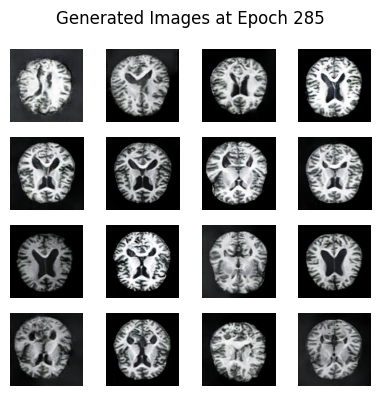

[Evaluation] FID: 2.38 | Precision: 0.350 | Recall: 0.414
[Evaluation] MMD: 0.0052 | 1-NN: 0.7061 | CID: {'creativity': np.float64(2.487886652876176), 'inheritance': np.float32(0.98461175), 'diversity': np.float64(5.620715300453176), 'cid_score': np.float64(8.123990203680304)}
Epoch 286, d_loss: 0.5151, g_loss: 1.1901, time: 13.86s
Epoch 287, d_loss: 0.5038, g_loss: 0.9392, time: 17.33s
Epoch 288, d_loss: 0.5040, g_loss: 0.9829, time: 13.93s
Epoch 289, d_loss: 0.5769, g_loss: 1.2168, time: 17.54s
Epoch 290, d_loss: 0.4987, g_loss: 1.1233, time: 13.94s


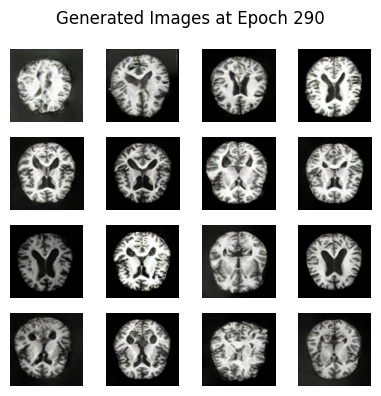

[Evaluation] FID: 3.29 | Precision: 0.631 | Recall: 0.465
[Evaluation] MMD: 0.0060 | 1-NN: 0.6953 | CID: {'creativity': np.float64(2.0512110762726072), 'inheritance': np.float32(0.989744), 'diversity': np.float64(4.553890354207082), 'cid_score': np.float64(6.615357422892257)}
Epoch 291, d_loss: 0.4309, g_loss: 1.6248, time: 14.18s
Epoch 292, d_loss: 0.5330, g_loss: 0.8645, time: 13.89s
Epoch 293, d_loss: 0.5683, g_loss: 1.0491, time: 17.79s
Epoch 294, d_loss: 0.5105, g_loss: 0.7326, time: 14.48s
Epoch 295, d_loss: 0.5459, g_loss: 0.9951, time: 16.22s


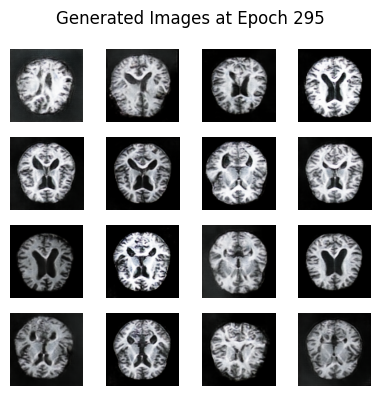

[Evaluation] FID: 2.11 | Precision: 0.545 | Recall: 0.465
[Evaluation] MMD: 0.0052 | 1-NN: 0.6758 | CID: {'creativity': np.float64(2.2096264458635915), 'inheritance': np.float32(0.9878316), 'diversity': np.float64(5.09836197221169), 'cid_score': np.float64(7.320156825515467)}
Epoch 296, d_loss: 0.5456, g_loss: 1.2121, time: 17.30s
Epoch 297, d_loss: 0.5014, g_loss: 0.9740, time: 14.55s
Epoch 298, d_loss: 0.4568, g_loss: 1.1477, time: 14.60s
Epoch 299, d_loss: 0.5135, g_loss: 1.0770, time: 16.23s
Epoch 300, d_loss: 0.5338, g_loss: 0.8286, time: 14.05s


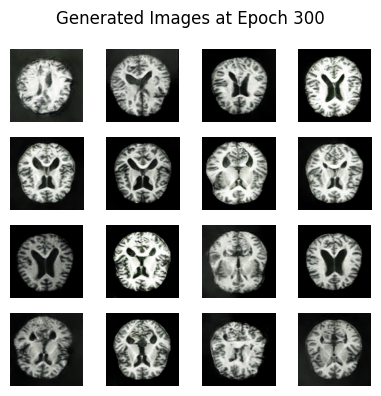

[Evaluation] FID: 1.77 | Precision: 0.459 | Recall: 0.438
[Evaluation] MMD: 0.0048 | 1-NN: 0.6377 | CID: {'creativity': np.float64(2.3251122924049685), 'inheritance': np.float32(0.98639035), 'diversity': np.float64(5.4097143019047), 'cid_score': np.float64(7.748436242060523)}
Epoch 301, d_loss: 0.4816, g_loss: 1.2933, time: 14.19s
Epoch 302, d_loss: 0.5250, g_loss: 0.9321, time: 16.88s
Epoch 303, d_loss: 0.5674, g_loss: 0.9817, time: 14.15s
Epoch 304, d_loss: 0.4472, g_loss: 1.4242, time: 16.99s
Epoch 305, d_loss: 0.4979, g_loss: 1.0699, time: 14.30s


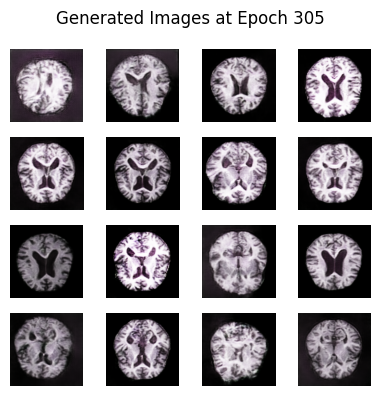

[Evaluation] FID: 2.28 | Precision: 0.523 | Recall: 0.434
[Evaluation] MMD: 0.0052 | 1-NN: 0.6865 | CID: {'creativity': np.float64(2.2033699086296012), 'inheritance': np.float32(0.98787814), 'diversity': np.float64(5.1533192601779705), 'cid_score': np.float64(7.368811025020188)}
Epoch 306, d_loss: 0.5470, g_loss: 0.9888, time: 16.99s
Epoch 307, d_loss: 0.5392, g_loss: 1.3137, time: 14.13s
Epoch 308, d_loss: 0.4682, g_loss: 1.1420, time: 17.05s
Epoch 309, d_loss: 0.4851, g_loss: 1.1309, time: 14.14s
Epoch 310, d_loss: 0.5174, g_loss: 1.0822, time: 17.05s


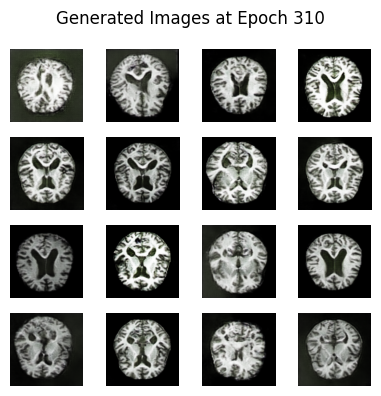

[Evaluation] FID: 2.21 | Precision: 0.379 | Recall: 0.408
[Evaluation] MMD: 0.0055 | 1-NN: 0.7148 | CID: {'creativity': np.float64(2.431785310612918), 'inheritance': np.float32(0.9852502), 'diversity': np.float64(5.429509434814398), 'cid_score': np.float64(7.876044570428079)}
Epoch 311, d_loss: 0.4481, g_loss: 1.2727, time: 14.30s
Epoch 312, d_loss: 0.5205, g_loss: 1.0764, time: 16.85s
Epoch 313, d_loss: 0.5412, g_loss: 0.9109, time: 14.15s
Epoch 314, d_loss: 0.5485, g_loss: 0.9886, time: 16.99s
Epoch 315, d_loss: 0.5787, g_loss: 1.2519, time: 14.15s


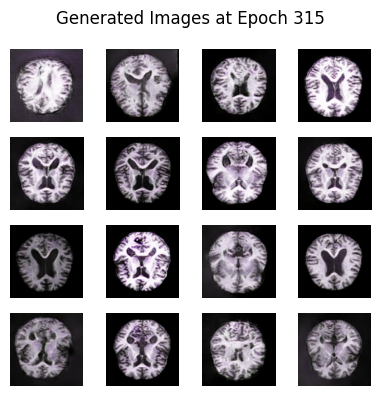

[Evaluation] FID: 4.06 | Precision: 0.648 | Recall: 0.438
[Evaluation] MMD: 0.0074 | 1-NN: 0.6934 | CID: {'creativity': np.float64(1.992919150022251), 'inheritance': np.float32(0.990352), 'diversity': np.float64(4.432734421379734), 'cid_score': np.float64(6.435301596437843)}
Epoch 316, d_loss: 0.5637, g_loss: 1.4042, time: 14.21s
Epoch 317, d_loss: 0.5021, g_loss: 1.0434, time: 14.27s
Epoch 318, d_loss: 0.5568, g_loss: 1.0028, time: 16.96s
Epoch 319, d_loss: 0.5080, g_loss: 1.4303, time: 14.16s
Epoch 320, d_loss: 0.4810, g_loss: 1.3029, time: 17.03s


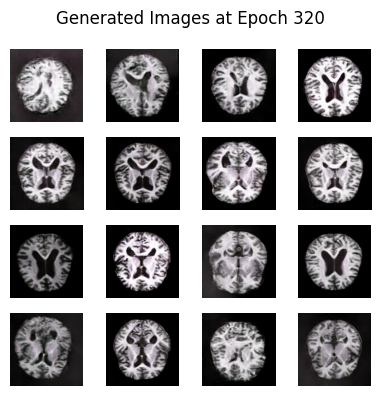

[Evaluation] FID: 3.03 | Precision: 0.490 | Recall: 0.436
[Evaluation] MMD: 0.0057 | 1-NN: 0.6982 | CID: {'creativity': np.float64(2.2060356286649627), 'inheritance': np.float32(0.98815155), 'diversity': np.float64(4.820505810275106), 'cid_score': np.float64(7.0383898886471)}
Epoch 321, d_loss: 0.5970, g_loss: 0.8632, time: 16.99s
Epoch 322, d_loss: 0.5395, g_loss: 1.1651, time: 14.19s
Epoch 323, d_loss: 0.4539, g_loss: 0.9714, time: 14.28s
Epoch 324, d_loss: 0.4303, g_loss: 0.9875, time: 16.89s
Epoch 325, d_loss: 0.5981, g_loss: 1.1256, time: 14.18s


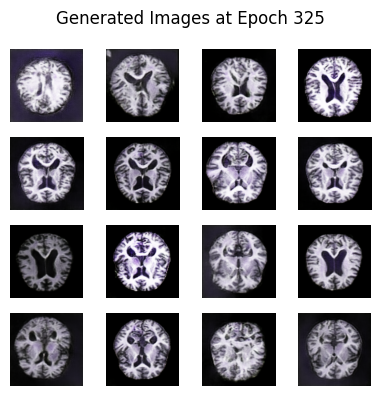

[Evaluation] FID: 3.34 | Precision: 0.572 | Recall: 0.430
[Evaluation] MMD: 0.0059 | 1-NN: 0.7061 | CID: {'creativity': np.float64(2.1192441363265697), 'inheritance': np.float32(0.98899347), 'diversity': np.float64(4.83597692506124), 'cid_score': np.float64(6.966227595487388)}
Epoch 326, d_loss: 0.5334, g_loss: 0.9105, time: 14.11s
Epoch 327, d_loss: 0.5001, g_loss: 0.9907, time: 17.05s
Epoch 328, d_loss: 0.5620, g_loss: 1.0920, time: 14.20s
Epoch 329, d_loss: 0.5193, g_loss: 0.8865, time: 14.32s
Epoch 330, d_loss: 0.5235, g_loss: 1.0081, time: 17.02s


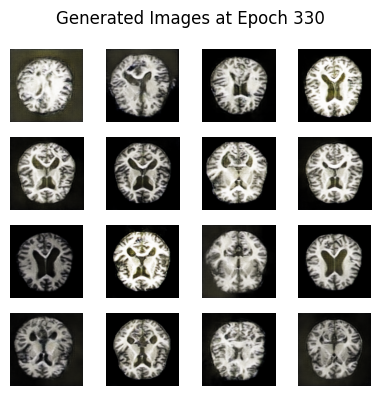

[Evaluation] FID: 2.74 | Precision: 0.600 | Recall: 0.469
[Evaluation] MMD: 0.0064 | 1-NN: 0.6816 | CID: {'creativity': np.float64(2.112420131765614), 'inheritance': np.float32(0.9892293), 'diversity': np.float64(4.670414884128932), 'cid_score': np.float64(6.793605694414749)}
Epoch 331, d_loss: 0.5778, g_loss: 0.8818, time: 16.99s
Epoch 332, d_loss: 0.5281, g_loss: 0.9774, time: 14.05s
Epoch 333, d_loss: 0.4339, g_loss: 1.5476, time: 17.03s
Epoch 334, d_loss: 0.3699, g_loss: 1.2879, time: 14.16s
Epoch 335, d_loss: 0.5697, g_loss: 1.0997, time: 14.24s


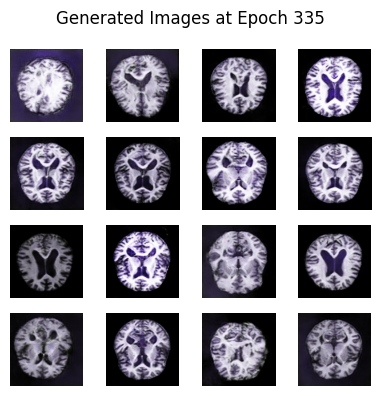

[Evaluation] FID: 3.15 | Precision: 0.521 | Recall: 0.432
[Evaluation] MMD: 0.0055 | 1-NN: 0.7178 | CID: {'creativity': np.float64(2.1443763335324597), 'inheritance': np.float32(0.988829), 'diversity': np.float64(4.801661925084963), 'cid_score': np.float64(6.9572092419319365)}
Epoch 336, d_loss: 0.5337, g_loss: 0.7855, time: 13.88s
Epoch 337, d_loss: 0.5123, g_loss: 1.2408, time: 17.30s
Epoch 338, d_loss: 0.4905, g_loss: 1.2935, time: 13.98s
Epoch 339, d_loss: 0.5775, g_loss: 1.2259, time: 17.07s
Epoch 340, d_loss: 0.5400, g_loss: 1.4094, time: 14.27s


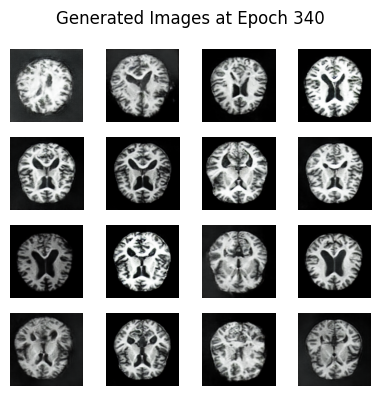

[Evaluation] FID: 1.95 | Precision: 0.432 | Recall: 0.414
[Evaluation] MMD: 0.0052 | 1-NN: 0.7139 | CID: {'creativity': np.float64(2.3240994100076007), 'inheritance': np.float32(0.9866855), 'diversity': np.float64(5.281613129910945), 'cid_score': np.float64(7.619027025468473)}
Epoch 341, d_loss: 0.5376, g_loss: 0.9155, time: 17.58s
Epoch 342, d_loss: 0.5129, g_loss: 1.0446, time: 14.26s
Epoch 343, d_loss: 0.5784, g_loss: 1.2063, time: 16.44s
Epoch 344, d_loss: 0.5440, g_loss: 1.0169, time: 14.00s
Epoch 345, d_loss: 0.5257, g_loss: 0.6556, time: 17.32s


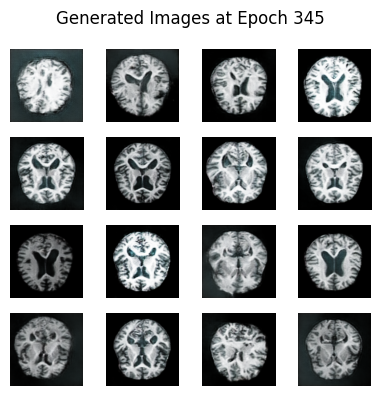

[Evaluation] FID: 2.03 | Precision: 0.535 | Recall: 0.428
[Evaluation] MMD: 0.0053 | 1-NN: 0.6875 | CID: {'creativity': np.float64(2.1904842164490064), 'inheritance': np.float32(0.9880235), 'diversity': np.float64(5.083970586248721), 'cid_score': np.float64(7.286431283181736)}
Epoch 346, d_loss: 0.5183, g_loss: 0.9812, time: 14.01s
Epoch 347, d_loss: 0.5621, g_loss: 1.1075, time: 16.02s
Epoch 348, d_loss: 0.5028, g_loss: 1.1421, time: 13.90s
Epoch 349, d_loss: 0.4851, g_loss: 1.2189, time: 18.03s
Epoch 350, d_loss: 0.5359, g_loss: 0.8321, time: 14.51s


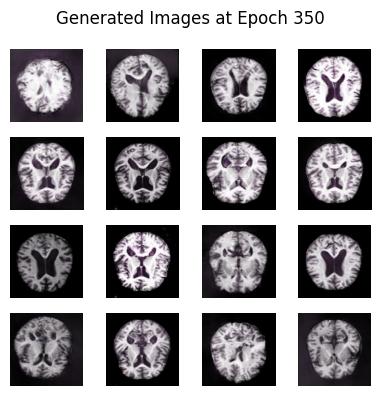

[Evaluation] FID: 3.65 | Precision: 0.641 | Recall: 0.457
[Evaluation] MMD: 0.0061 | 1-NN: 0.6895 | CID: {'creativity': np.float64(2.0359985468099735), 'inheritance': np.float32(0.98994887), 'diversity': np.float64(4.413639309408812), 'cid_score': np.float64(6.45968898746726)}
Epoch 351, d_loss: 0.4557, g_loss: 0.9626, time: 13.92s
Epoch 352, d_loss: 0.5185, g_loss: 1.0612, time: 14.11s
Epoch 353, d_loss: 0.5402, g_loss: 1.2569, time: 17.75s
Epoch 354, d_loss: 0.4790, g_loss: 1.6694, time: 13.89s
Epoch 355, d_loss: 0.5240, g_loss: 1.0857, time: 17.35s


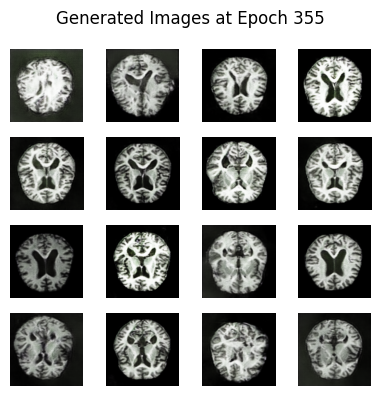

[Evaluation] FID: 2.05 | Precision: 0.393 | Recall: 0.438
[Evaluation] MMD: 0.0052 | 1-NN: 0.6934 | CID: {'creativity': np.float64(2.385476846040453), 'inheritance': np.float32(0.9858415), 'diversity': np.float64(5.323923837172116), 'cid_score': np.float64(7.723559170532516)}
Epoch 356, d_loss: 0.4837, g_loss: 0.9590, time: 13.89s
Epoch 357, d_loss: 0.5520, g_loss: 0.6217, time: 17.33s
Epoch 358, d_loss: 0.5544, g_loss: 1.2382, time: 13.87s
Epoch 359, d_loss: 0.4332, g_loss: 1.4943, time: 17.42s
Epoch 360, d_loss: 0.4969, g_loss: 1.3650, time: 13.84s


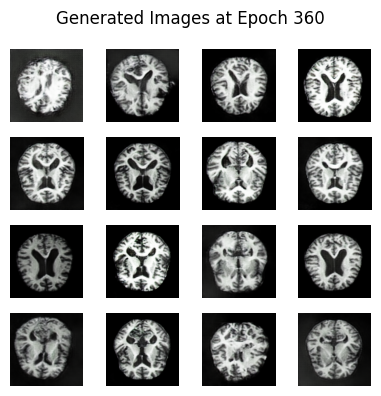

[Evaluation] FID: 2.60 | Precision: 0.562 | Recall: 0.455
[Evaluation] MMD: 0.0054 | 1-NN: 0.7061 | CID: {'creativity': np.float64(2.18401566674068), 'inheritance': np.float32(0.98816097), 'diversity': np.float64(4.925647295088662), 'cid_score': np.float64(7.121501994002498)}
Epoch 361, d_loss: 0.4713, g_loss: 0.9149, time: 17.31s
Epoch 362, d_loss: 0.4847, g_loss: 1.4544, time: 13.90s
Epoch 363, d_loss: 0.5553, g_loss: 0.7510, time: 17.68s
Epoch 364, d_loss: 0.5186, g_loss: 1.3540, time: 14.47s
Epoch 365, d_loss: 0.5427, g_loss: 1.1688, time: 16.93s


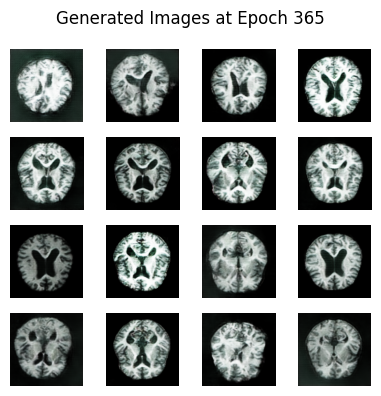

[Evaluation] FID: 3.70 | Precision: 0.537 | Recall: 0.391
[Evaluation] MMD: 0.0064 | 1-NN: 0.7539 | CID: {'creativity': np.float64(2.1839929657187263), 'inheritance': np.float32(0.98801196), 'diversity': np.float64(4.915977418449817), 'cid_score': np.float64(7.111958427953638)}
Epoch 366, d_loss: 0.5031, g_loss: 1.2309, time: 16.69s
Epoch 367, d_loss: 0.4451, g_loss: 1.2098, time: 14.18s
Epoch 368, d_loss: 0.5706, g_loss: 1.2725, time: 14.13s
Epoch 369, d_loss: 0.5079, g_loss: 1.1762, time: 17.31s
Epoch 370, d_loss: 0.6181, g_loss: 0.7019, time: 14.01s


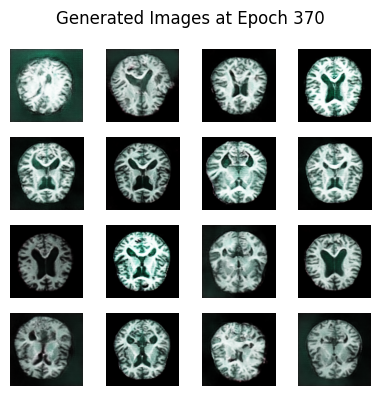

[Evaluation] FID: 2.06 | Precision: 0.459 | Recall: 0.439
[Evaluation] MMD: 0.0050 | 1-NN: 0.7012 | CID: {'creativity': np.float64(2.2671500937004954), 'inheritance': np.float32(0.98721623), 'diversity': np.float64(5.10253174651191), 'cid_score': np.float64(7.382465606005252)}
Epoch 371, d_loss: 0.4977, g_loss: 1.0578, time: 14.20s
Epoch 372, d_loss: 0.4725, g_loss: 1.5550, time: 14.08s
Epoch 373, d_loss: 0.4760, g_loss: 1.2297, time: 17.10s
Epoch 374, d_loss: 0.5969, g_loss: 0.6376, time: 14.00s
Epoch 375, d_loss: 0.5425, g_loss: 0.7264, time: 17.13s


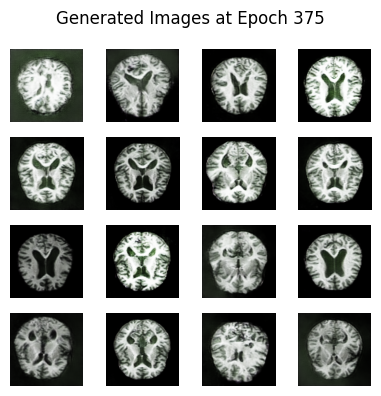

[Evaluation] FID: 2.15 | Precision: 0.471 | Recall: 0.426
[Evaluation] MMD: 0.0048 | 1-NN: 0.6846 | CID: {'creativity': np.float64(2.218610234006014), 'inheritance': np.float32(0.98781323), 'diversity': np.float64(4.974483899423095), 'cid_score': np.float64(7.205280899099886)}
Epoch 376, d_loss: 0.5892, g_loss: 1.1253, time: 17.11s
Epoch 377, d_loss: 0.5861, g_loss: 1.3462, time: 14.17s
Epoch 378, d_loss: 0.5002, g_loss: 1.0352, time: 14.12s
Epoch 379, d_loss: 0.4845, g_loss: 0.9682, time: 17.13s
Epoch 380, d_loss: 0.4723, g_loss: 1.0846, time: 14.00s


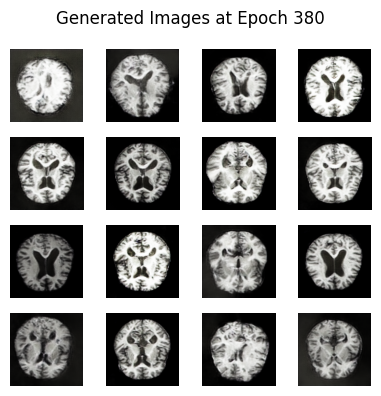

[Evaluation] FID: 2.50 | Precision: 0.523 | Recall: 0.438
[Evaluation] MMD: 0.0052 | 1-NN: 0.7061 | CID: {'creativity': np.float64(2.179814622441291), 'inheritance': np.float32(0.98815674), 'diversity': np.float64(5.1030184220748875), 'cid_score': np.float64(7.294676308619114)}
Epoch 381, d_loss: 0.5140, g_loss: 1.4240, time: 14.12s
Epoch 382, d_loss: 0.4722, g_loss: 0.9819, time: 14.22s
Epoch 383, d_loss: 0.5133, g_loss: 0.8921, time: 17.06s
Epoch 384, d_loss: 0.4768, g_loss: 1.3941, time: 14.15s
Epoch 385, d_loss: 0.4725, g_loss: 1.2570, time: 17.13s


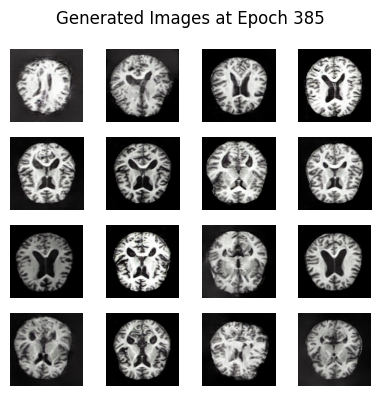

[Evaluation] FID: 1.63 | Precision: 0.455 | Recall: 0.428
[Evaluation] MMD: 0.0047 | 1-NN: 0.6631 | CID: {'creativity': np.float64(2.3018426622999906), 'inheritance': np.float32(0.98678076), 'diversity': np.float64(5.443397141621385), 'cid_score': np.float64(7.758459041248951)}
Epoch 386, d_loss: 0.5906, g_loss: 0.9149, time: 17.10s
Epoch 387, d_loss: 0.5530, g_loss: 0.9844, time: 14.11s
Epoch 388, d_loss: 0.5605, g_loss: 0.9111, time: 14.18s
Epoch 389, d_loss: 0.6170, g_loss: 0.9824, time: 17.09s
Epoch 390, d_loss: 0.6096, g_loss: 1.7054, time: 14.08s


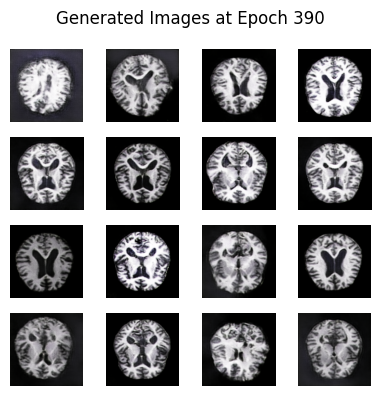

[Evaluation] FID: 2.01 | Precision: 0.469 | Recall: 0.447
[Evaluation] MMD: 0.0054 | 1-NN: 0.7139 | CID: {'creativity': np.float64(2.2759715736686585), 'inheritance': np.float32(0.98717433), 'diversity': np.float64(5.178803232093693), 'cid_score': np.float64(7.467600473620475)}
Epoch 391, d_loss: 0.4480, g_loss: 1.1268, time: 14.11s
Epoch 392, d_loss: 0.5306, g_loss: 0.7591, time: 14.03s
Epoch 393, d_loss: 0.5596, g_loss: 1.1889, time: 17.24s
Epoch 394, d_loss: 0.4015, g_loss: 1.3501, time: 14.17s
Epoch 395, d_loss: 0.5037, g_loss: 1.0921, time: 17.05s


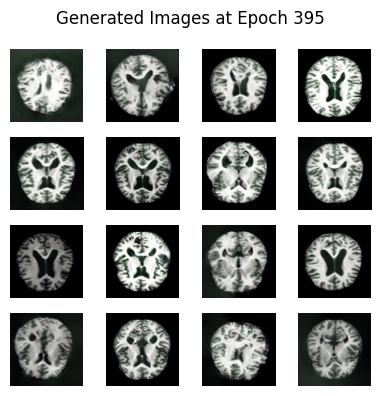

[Evaluation] FID: 1.87 | Precision: 0.428 | Recall: 0.428
[Evaluation] MMD: 0.0048 | 1-NN: 0.6650 | CID: {'creativity': np.float64(2.352411908249683), 'inheritance': np.float32(0.9860124), 'diversity': np.float64(5.52891371582241), 'cid_score': np.float64(7.895313224875469)}
Epoch 396, d_loss: 0.4861, g_loss: 1.0618, time: 14.16s
Epoch 397, d_loss: 0.4555, g_loss: 0.9853, time: 18.49s
Epoch 398, d_loss: 0.4934, g_loss: 1.2044, time: 13.96s
Epoch 399, d_loss: 0.5476, g_loss: 1.2836, time: 13.96s
Epoch 400, d_loss: 0.4893, g_loss: 1.0733, time: 17.43s


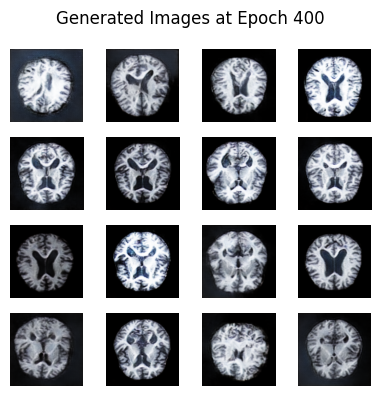

[Evaluation] FID: 3.88 | Precision: 0.646 | Recall: 0.473
[Evaluation] MMD: 0.0064 | 1-NN: 0.6875 | CID: {'creativity': np.float64(1.9972846049165203), 'inheritance': np.float32(0.9904163), 'diversity': np.float64(4.411166889572415), 'cid_score': np.float64(6.418035206113081)}
Epoch 401, d_loss: 0.4136, g_loss: 1.2691, time: 16.99s
Epoch 402, d_loss: 0.4603, g_loss: 1.1264, time: 14.19s
Epoch 403, d_loss: 0.4670, g_loss: 1.6162, time: 14.12s
Epoch 404, d_loss: 0.5993, g_loss: 1.3605, time: 17.06s
Epoch 405, d_loss: 0.6255, g_loss: 0.7937, time: 14.19s


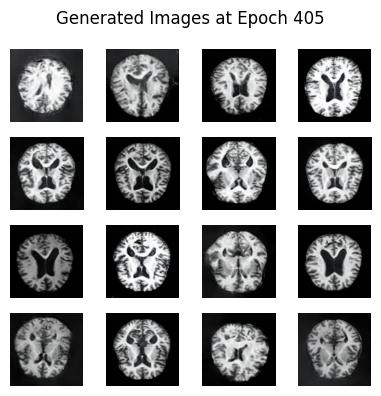

[Evaluation] FID: 2.26 | Precision: 0.428 | Recall: 0.410
[Evaluation] MMD: 0.0047 | 1-NN: 0.6924 | CID: {'creativity': np.float64(2.2703019552253614), 'inheritance': np.float32(0.98737144), 'diversity': np.float64(5.116529728390744), 'cid_score': np.float64(7.3994602389139565)}
Epoch 406, d_loss: 0.4183, g_loss: 1.1794, time: 14.10s
Epoch 407, d_loss: 0.6065, g_loss: 0.7220, time: 17.05s
Epoch 408, d_loss: 0.4739, g_loss: 0.7932, time: 14.15s
Epoch 409, d_loss: 0.5294, g_loss: 0.8965, time: 17.09s
Epoch 410, d_loss: 0.4343, g_loss: 1.1818, time: 14.21s


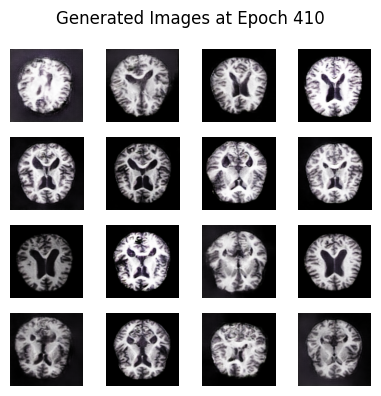

[Evaluation] FID: 2.88 | Precision: 0.564 | Recall: 0.449
[Evaluation] MMD: 0.0056 | 1-NN: 0.6914 | CID: {'creativity': np.float64(2.1361932525762866), 'inheritance': np.float32(0.98873115), 'diversity': np.float64(4.868284860602737), 'cid_score': np.float64(7.015746967320259)}
Epoch 411, d_loss: 0.4757, g_loss: 1.5319, time: 17.11s
Epoch 412, d_loss: 0.4313, g_loss: 1.2413, time: 14.16s
Epoch 413, d_loss: 0.5552, g_loss: 0.7172, time: 17.01s
Epoch 414, d_loss: 0.4270, g_loss: 1.3381, time: 14.01s
Epoch 415, d_loss: 0.5392, g_loss: 1.1440, time: 13.96s


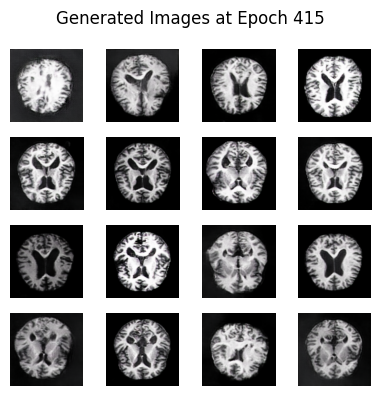

[Evaluation] FID: 2.20 | Precision: 0.539 | Recall: 0.453
[Evaluation] MMD: 0.0054 | 1-NN: 0.6670 | CID: {'creativity': np.float64(2.17404165627736), 'inheritance': np.float32(0.9883003), 'diversity': np.float64(4.973221591765463), 'cid_score': np.float64(7.158962924556494)}
Epoch 416, d_loss: 0.4246, g_loss: 1.0764, time: 13.93s
Epoch 417, d_loss: 0.5328, g_loss: 1.2647, time: 17.20s
Epoch 418, d_loss: 0.4988, g_loss: 1.1517, time: 14.42s
Epoch 419, d_loss: 0.5112, g_loss: 0.8942, time: 13.89s
Epoch 420, d_loss: 0.4912, g_loss: 1.0277, time: 16.90s


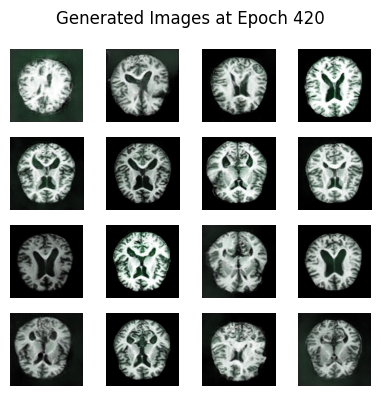

[Evaluation] FID: 2.49 | Precision: 0.521 | Recall: 0.445
[Evaluation] MMD: 0.0052 | 1-NN: 0.6582 | CID: {'creativity': np.float64(2.1347457997238983), 'inheritance': np.float32(0.9887693), 'diversity': np.float64(4.899446646565903), 'cid_score': np.float64(7.045423153458381)}
Epoch 421, d_loss: 0.3702, g_loss: 1.5454, time: 17.53s
Epoch 422, d_loss: 0.5098, g_loss: 0.9789, time: 14.54s
Epoch 423, d_loss: 0.6249, g_loss: 0.6067, time: 16.37s
Epoch 424, d_loss: 0.4283, g_loss: 1.2268, time: 13.92s
Epoch 425, d_loss: 0.6129, g_loss: 0.8378, time: 13.94s


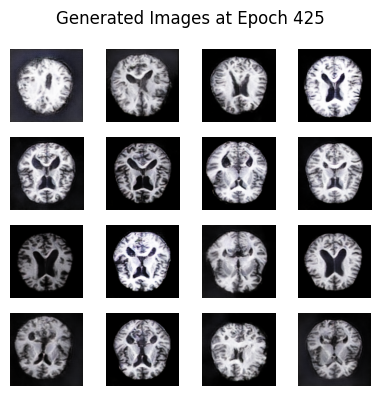

[Evaluation] FID: 2.30 | Precision: 0.520 | Recall: 0.428
[Evaluation] MMD: 0.0053 | 1-NN: 0.6562 | CID: {'creativity': np.float64(2.1837601644681452), 'inheritance': np.float32(0.9881291), 'diversity': np.float64(4.968211237587053), 'cid_score': np.float64(7.16384232271331)}
Epoch 426, d_loss: 0.5560, g_loss: 1.1243, time: 14.68s
Epoch 427, d_loss: 0.4640, g_loss: 1.0540, time: 15.97s
Epoch 428, d_loss: 0.4781, g_loss: 1.1010, time: 13.90s
Epoch 429, d_loss: 0.4888, g_loss: 0.9785, time: 14.04s
Epoch 430, d_loss: 0.6225, g_loss: 1.1625, time: 18.30s


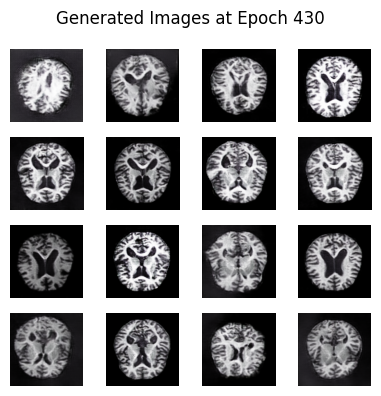

[Evaluation] FID: 2.59 | Precision: 0.387 | Recall: 0.393
[Evaluation] MMD: 0.0054 | 1-NN: 0.7402 | CID: {'creativity': np.float64(2.423786028362845), 'inheritance': np.float32(0.9854483), 'diversity': np.float64(5.314806765642288), 'cid_score': np.float64(7.753144493166663)}
Epoch 431, d_loss: 0.4913, g_loss: 1.4780, time: 16.39s
Epoch 432, d_loss: 0.4726, g_loss: 1.0553, time: 13.89s
Epoch 433, d_loss: 0.4814, g_loss: 0.9173, time: 17.71s
Epoch 434, d_loss: 0.5110, g_loss: 1.0969, time: 13.92s
Epoch 435, d_loss: 0.5049, g_loss: 0.7627, time: 13.85s


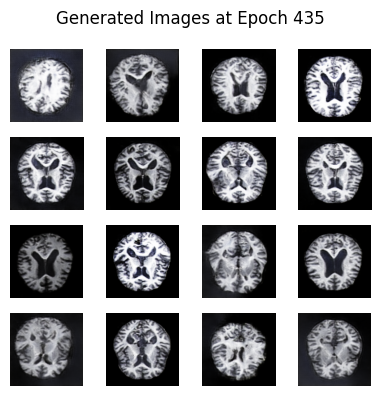

[Evaluation] FID: 2.43 | Precision: 0.488 | Recall: 0.436
[Evaluation] MMD: 0.0051 | 1-NN: 0.7139 | CID: {'creativity': np.float64(2.228269081034095), 'inheritance': np.float32(0.98780096), 'diversity': np.float64(4.851242713396875), 'cid_score': np.float64(7.09171083865857)}
Epoch 436, d_loss: 0.5546, g_loss: 1.3713, time: 14.19s
Epoch 437, d_loss: 0.5158, g_loss: 1.5665, time: 16.81s
Epoch 438, d_loss: 0.4866, g_loss: 1.0465, time: 14.21s
Epoch 439, d_loss: 0.5387, g_loss: 0.7759, time: 16.90s
Epoch 440, d_loss: 0.4077, g_loss: 1.3209, time: 14.18s


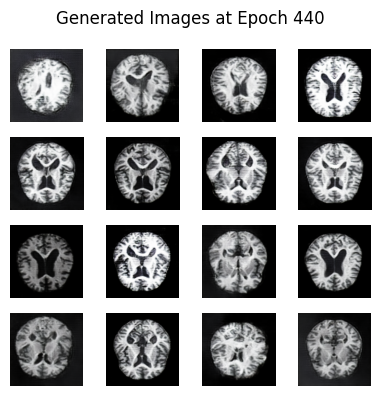

[Evaluation] FID: 1.80 | Precision: 0.498 | Recall: 0.420
[Evaluation] MMD: 0.0047 | 1-NN: 0.6523 | CID: {'creativity': np.float64(2.210732372411132), 'inheritance': np.float32(0.9879024), 'diversity': np.float64(5.197730812414125), 'cid_score': np.float64(7.420560781947449)}
Epoch 441, d_loss: 0.4684, g_loss: 0.9596, time: 16.96s
Epoch 442, d_loss: 0.4496, g_loss: 1.5821, time: 13.95s
Epoch 443, d_loss: 0.4721, g_loss: 1.5998, time: 17.35s
Epoch 444, d_loss: 0.5041, g_loss: 0.9025, time: 14.20s
Epoch 445, d_loss: 0.4460, g_loss: 1.4690, time: 14.19s


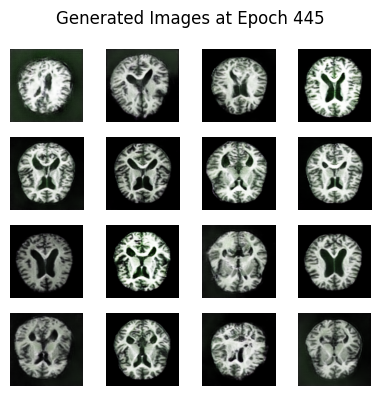

[Evaluation] FID: 2.80 | Precision: 0.434 | Recall: 0.447
[Evaluation] MMD: 0.0051 | 1-NN: 0.7061 | CID: {'creativity': np.float64(2.338917875180534), 'inheritance': np.float32(0.9862248), 'diversity': np.float64(5.251350450985554), 'cid_score': np.float64(7.6040435556201285)}
Epoch 446, d_loss: 0.5306, g_loss: 0.9210, time: 14.23s
Epoch 447, d_loss: 0.5669, g_loss: 0.6927, time: 16.93s
Epoch 448, d_loss: 0.4447, g_loss: 1.1407, time: 14.16s
Epoch 449, d_loss: 0.4966, g_loss: 0.8991, time: 17.05s
Epoch 450, d_loss: 0.6139, g_loss: 0.9858, time: 14.23s


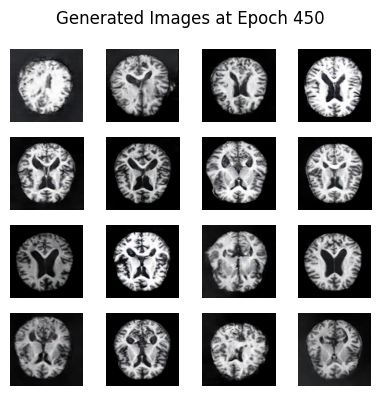

[Evaluation] FID: 2.75 | Precision: 0.535 | Recall: 0.445
[Evaluation] MMD: 0.0051 | 1-NN: 0.6768 | CID: {'creativity': np.float64(2.1520430522315515), 'inheritance': np.float32(0.9886368), 'diversity': np.float64(4.785409431231942), 'cid_score': np.float64(6.948815691757408)}
Epoch 451, d_loss: 0.6476, g_loss: 1.0560, time: 17.04s
Epoch 452, d_loss: 0.4345, g_loss: 1.4050, time: 14.22s
Epoch 453, d_loss: 0.5208, g_loss: 0.9794, time: 16.99s
Epoch 454, d_loss: 0.4490, g_loss: 1.1961, time: 14.17s
Epoch 455, d_loss: 0.5354, g_loss: 1.3334, time: 16.96s


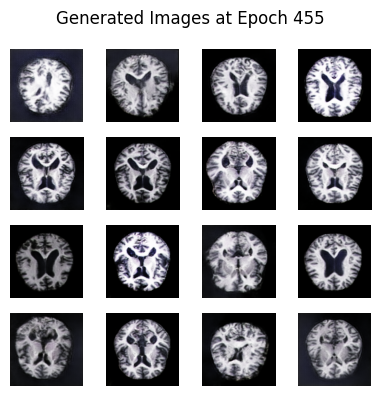

[Evaluation] FID: 2.96 | Precision: 0.547 | Recall: 0.434
[Evaluation] MMD: 0.0055 | 1-NN: 0.6660 | CID: {'creativity': np.float64(2.15179478094025), 'inheritance': np.float32(0.98858607), 'diversity': np.float64(4.835796472421813), 'cid_score': np.float64(6.999005185208682)}
Epoch 456, d_loss: 0.5624, g_loss: 1.6301, time: 14.23s
Epoch 457, d_loss: 0.6169, g_loss: 1.2646, time: 16.97s
Epoch 458, d_loss: 0.4626, g_loss: 1.2445, time: 14.19s
Epoch 459, d_loss: 0.5397, g_loss: 0.9319, time: 16.96s
Epoch 460, d_loss: 0.5558, g_loss: 1.0371, time: 14.16s


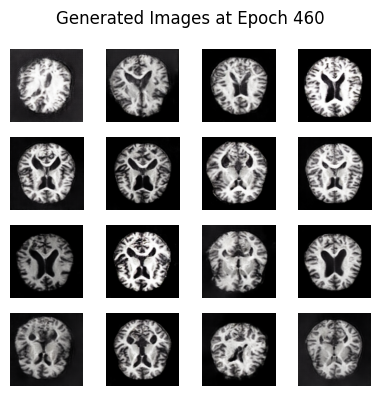

[Evaluation] FID: 2.55 | Precision: 0.389 | Recall: 0.428
[Evaluation] MMD: 0.0050 | 1-NN: 0.6953 | CID: {'creativity': np.float64(2.3435828783497454), 'inheritance': np.float32(0.98644686), 'diversity': np.float64(5.232568254483326), 'cid_score': np.float64(7.5897042753806785)}
Epoch 461, d_loss: 0.4667, g_loss: 1.2021, time: 16.98s
Epoch 462, d_loss: 0.4952, g_loss: 0.9838, time: 14.20s
Epoch 463, d_loss: 0.5942, g_loss: 1.5366, time: 17.00s
Epoch 464, d_loss: 0.5403, g_loss: 1.0574, time: 14.14s
Epoch 465, d_loss: 0.4479, g_loss: 1.3085, time: 17.18s


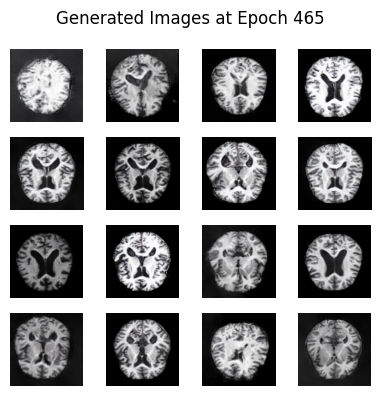

[Evaluation] FID: 2.55 | Precision: 0.600 | Recall: 0.459
[Evaluation] MMD: 0.0051 | 1-NN: 0.6611 | CID: {'creativity': np.float64(2.095052026580495), 'inheritance': np.float32(0.98916173), 'diversity': np.float64(4.876025236895744), 'cid_score': np.float64(6.981915533663617)}
Epoch 466, d_loss: 0.4360, g_loss: 1.1131, time: 14.00s
Epoch 467, d_loss: 0.4982, g_loss: 1.0460, time: 17.25s
Epoch 468, d_loss: 0.4053, g_loss: 1.4013, time: 14.15s
Epoch 469, d_loss: 0.5013, g_loss: 1.0507, time: 17.02s
Epoch 470, d_loss: 0.4899, g_loss: 0.9397, time: 14.17s


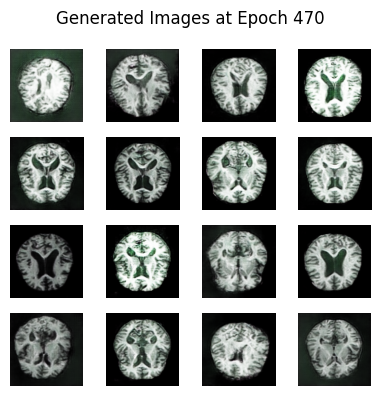

[Evaluation] FID: 3.87 | Precision: 0.621 | Recall: 0.420
[Evaluation] MMD: 0.0068 | 1-NN: 0.7119 | CID: {'creativity': np.float64(2.0328923002515626), 'inheritance': np.float32(0.98995703), 'diversity': np.float64(4.565589893035391), 'cid_score': np.float64(6.608525158699093)}
Epoch 471, d_loss: 0.5949, g_loss: 1.2574, time: 17.13s
Epoch 472, d_loss: 0.6140, g_loss: 0.9487, time: 14.16s
Epoch 473, d_loss: 0.5295, g_loss: 1.3413, time: 17.13s
Epoch 474, d_loss: 0.5279, g_loss: 0.8184, time: 14.14s
Epoch 475, d_loss: 0.4601, g_loss: 1.6986, time: 17.06s


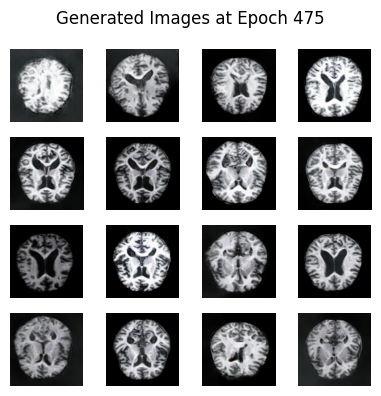

[Evaluation] FID: 3.80 | Precision: 0.645 | Recall: 0.473
[Evaluation] MMD: 0.0055 | 1-NN: 0.6719 | CID: {'creativity': np.float64(2.0135169159872497), 'inheritance': np.float32(0.99018764), 'diversity': np.float64(4.440975375094679), 'cid_score': np.float64(6.464304646123432)}
Epoch 476, d_loss: 0.5256, g_loss: 1.1234, time: 14.10s
Epoch 477, d_loss: 0.4868, g_loss: 1.1803, time: 17.13s
Epoch 478, d_loss: 0.5279, g_loss: 1.3164, time: 14.10s
Epoch 479, d_loss: 0.4450, g_loss: 1.1321, time: 17.11s
Epoch 480, d_loss: 0.4550, g_loss: 1.5667, time: 13.95s


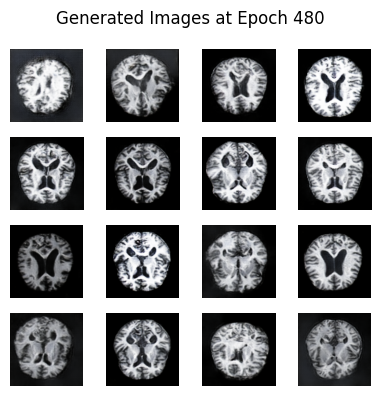

[Evaluation] FID: 2.80 | Precision: 0.545 | Recall: 0.445
[Evaluation] MMD: 0.0052 | 1-NN: 0.6709 | CID: {'creativity': np.float64(2.183177382608111), 'inheritance': np.float32(0.9881091), 'diversity': np.float64(5.12524192023601), 'cid_score': np.float64(7.320310191058232)}
Epoch 481, d_loss: 0.4585, g_loss: 0.9983, time: 17.41s
Epoch 482, d_loss: 0.6491, g_loss: 0.7385, time: 14.08s
Epoch 483, d_loss: 0.3803, g_loss: 1.4816, time: 17.24s
Epoch 484, d_loss: 0.5371, g_loss: 1.4352, time: 14.05s
Epoch 485, d_loss: 0.4882, g_loss: 1.2678, time: 17.22s


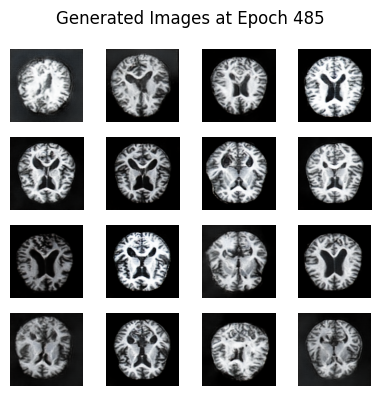

[Evaluation] FID: 2.22 | Precision: 0.508 | Recall: 0.451
[Evaluation] MMD: 0.0052 | 1-NN: 0.6973 | CID: {'creativity': np.float64(2.2200418616885838), 'inheritance': np.float32(0.98791015), 'diversity': np.float64(4.9441152954153615), 'cid_score': np.float64(7.176247005622317)}
Epoch 486, d_loss: 0.4865, g_loss: 1.0507, time: 13.95s
Epoch 487, d_loss: 0.4877, g_loss: 1.4801, time: 17.48s
Epoch 488, d_loss: 0.4786, g_loss: 1.0223, time: 13.86s
Epoch 489, d_loss: 0.4876, g_loss: 1.4755, time: 17.39s
Epoch 490, d_loss: 0.5002, g_loss: 0.8027, time: 14.47s


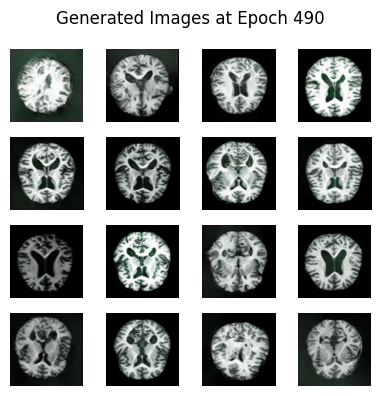

[Evaluation] FID: 1.68 | Precision: 0.461 | Recall: 0.434
[Evaluation] MMD: 0.0046 | 1-NN: 0.6699 | CID: {'creativity': np.float64(2.2551441944589707), 'inheritance': np.float32(0.9874338), 'diversity': np.float64(5.207094222263161), 'cid_score': np.float64(7.474804625561548)}
Epoch 491, d_loss: 0.4613, g_loss: 1.1955, time: 16.84s
Epoch 492, d_loss: 0.4524, g_loss: 1.2068, time: 13.90s
Epoch 493, d_loss: 0.4548, g_loss: 1.6392, time: 17.88s
Epoch 494, d_loss: 0.5014, g_loss: 1.4241, time: 14.64s
Epoch 495, d_loss: 0.4364, g_loss: 1.6339, time: 16.03s


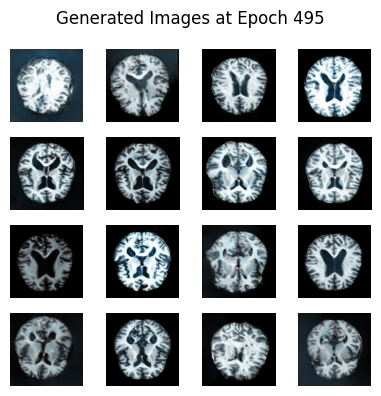

[Evaluation] FID: 2.04 | Precision: 0.416 | Recall: 0.428
[Evaluation] MMD: 0.0048 | 1-NN: 0.6738 | CID: {'creativity': np.float64(2.280091246283528), 'inheritance': np.float32(0.9871418), 'diversity': np.float64(5.176322461573093), 'cid_score': np.float64(7.469271919850792)}
Epoch 496, d_loss: 0.4545, g_loss: 1.4902, time: 14.04s
Epoch 497, d_loss: 0.5112, g_loss: 1.2037, time: 18.62s
Epoch 498, d_loss: 0.5507, g_loss: 0.9029, time: 14.24s
Epoch 499, d_loss: 0.4524, g_loss: 1.0792, time: 15.66s
Epoch 500, d_loss: 0.3963, g_loss: 1.1119, time: 13.86s


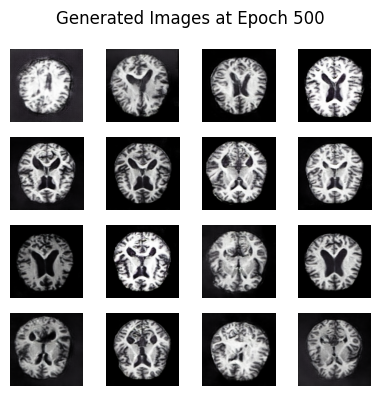

[Evaluation] FID: 2.07 | Precision: 0.402 | Recall: 0.430
[Evaluation] MMD: 0.0056 | 1-NN: 0.6816 | CID: {'creativity': np.float64(2.391195424309899), 'inheritance': np.float32(0.98594236), 'diversity': np.float64(5.24067914759822), 'cid_score': np.float64(7.645932208169105)}


In [24]:
# --- USAGE EXAMPLES ---
train(train_ds, EPOCHS, val_dataset=val_ds)

In [25]:
# Initialize the metric calculator using the test dataset for post-training evaluation
post_training_metric_calculator = GANMetrics(
    real_dataset=test_ds,
    latent_dim=LATENT_DIM,
    num_classes=NUM_CLASSES,
    batch_size=BATCH_SIZE,
    num_samples=512
)

# Evaluate GAN on the test dataset
evaluate_gan(generator, post_training_metric_calculator, LATENT_DIM, NUM_CLASSES)

[Evaluation] FID: 2.22 | Precision: 0.371 | Recall: 0.430
[Evaluation] MMD: 0.0054 | 1-NN: 0.6904 | CID: {'creativity': np.float64(2.3213783962597256), 'inheritance': np.float32(0.98673034), 'diversity': np.float64(5.10829712228015), 'cid_score': np.float64(7.442945181396931)}


(np.float64(2.2158941304418853),
 np.float64(0.37109375),
 np.float64(0.4296875),
 np.float32(0.005371155),
 np.float64(0.6904296875),
 {'creativity': np.float64(2.3213783962597256),
  'inheritance': np.float32(0.98673034),
  'diversity': np.float64(5.10829712228015),
  'cid_score': np.float64(7.442945181396931)})

In [33]:
def generate_class_images_batchwise(class_idx, total_images=1000, batch_size=16, output_dir=GENERATED_IMAGES_DIR):
    checkpoint.restore(tf.train.latest_checkpoint(CHECKPOINT_DIR)).expect_partial()

    class_folder = os.path.join(output_dir, f'class_{class_idx}')
    os.makedirs(class_folder, exist_ok=True)

    for start_idx in range(0, total_images, batch_size):
        current_batch_size = min(batch_size, total_images - start_idx)

        noise = tf.random.normal([current_batch_size, LATENT_DIM])
        labels = tf.constant([[class_idx]] * current_batch_size)

        generated = generator([noise, labels], training=False)
        generated = (generated + 1) / 2.0  # Scale to [0,1]

        for i in range(current_batch_size):
            img_path = os.path.join(class_folder, f'image_{start_idx + i:04d}.png')
            plt.imsave(img_path, generated[i].numpy())

# Usage
generate_class_images_batchwise(class_idx=0, total_images=1000, batch_size=16)


In [34]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    dataset_root,
    batch_size=32,
    image_size=(img_height, img_width))

class_names = train_ds.class_names  # List of class names ordered by index
print(class_names)


Found 12000 files belonging to 4 classes.
['MildDemented', 'ModerateDemented', 'NonDemented', 'VeryMildDemented']
